# Setup

In [1]:
%load_ext autoreload

In [2]:
%autoreload
from helpers import *
N=50
problem = DirectProblem(N)
V = problem.V
V_array_size = V.dofmap.index_map.size_global

# 1 Equation

## Setting - 1 Equation

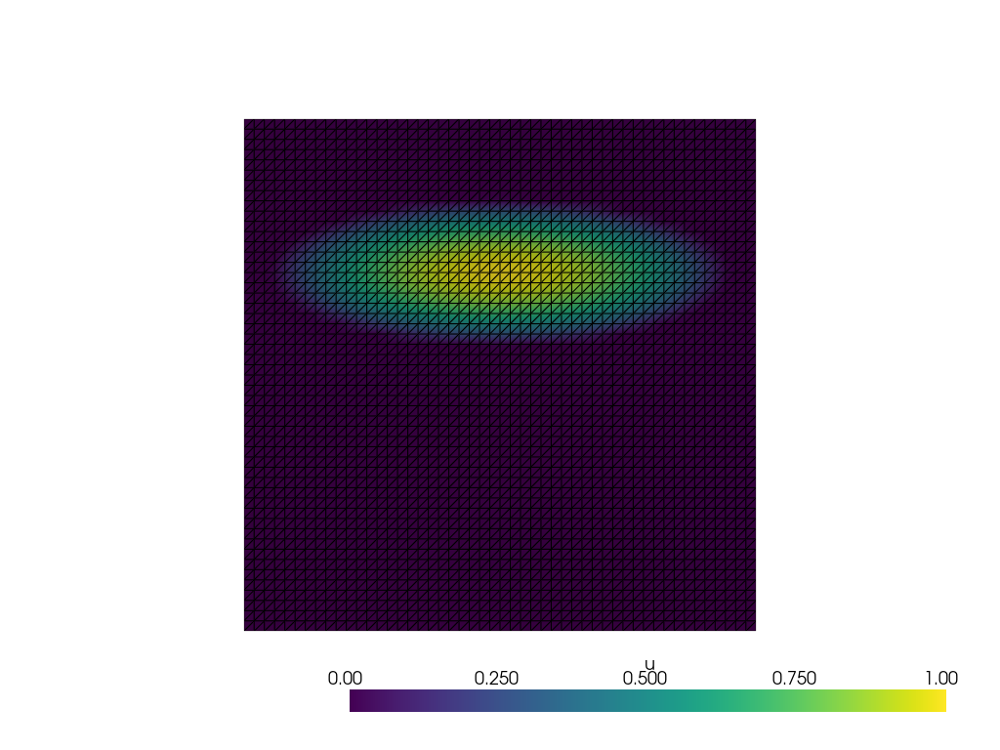

In [6]:
c = dolfinx.fem.Function(V)
const = 50
c.interpolate(lambda x: 1-0.1*const*(x[0]-0.5)**2-const*(x[1]-0.7)**2)
c.x.array[:] = np.where(c.x.array>=0, c.x.array, 0)
problem.plotFunc(c,warped=False)

# problem.plotFunc(c,warped=True)
f_list1 = problem.createFiList(1,0.25,f_value= 20)
u_list1 = problem.directOperator(c,f_list1)

In [7]:
print("C norm", funcSquareNorm(c)**0.5)
print("u norm", funcSquareNorm(u_list1[0])**0.5)

C norm 0.25603038465515526
u norm 0.33784875991944047


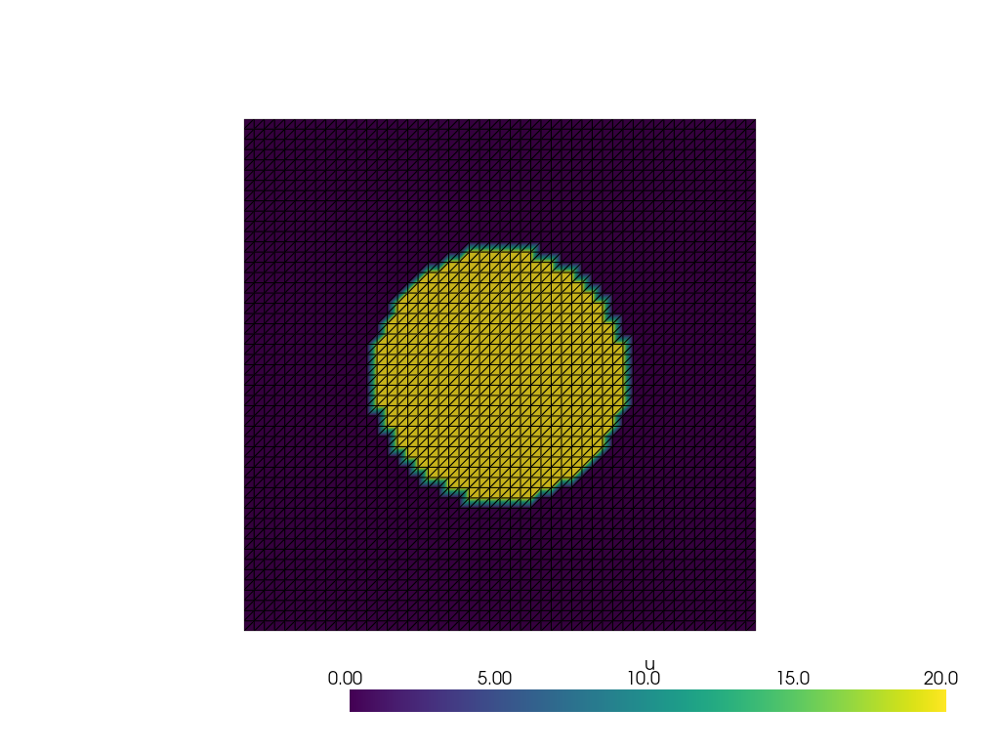

In [8]:
plotFuncList(f_list1)

- aumentar o suporte da $f$
- aumentar o valor da u/f
- fazer a c uma elipse
- mexer na discrepancia
- fazer com 2 ou 3 níveis de ruído - 1 pequeno e 1 grande
- 

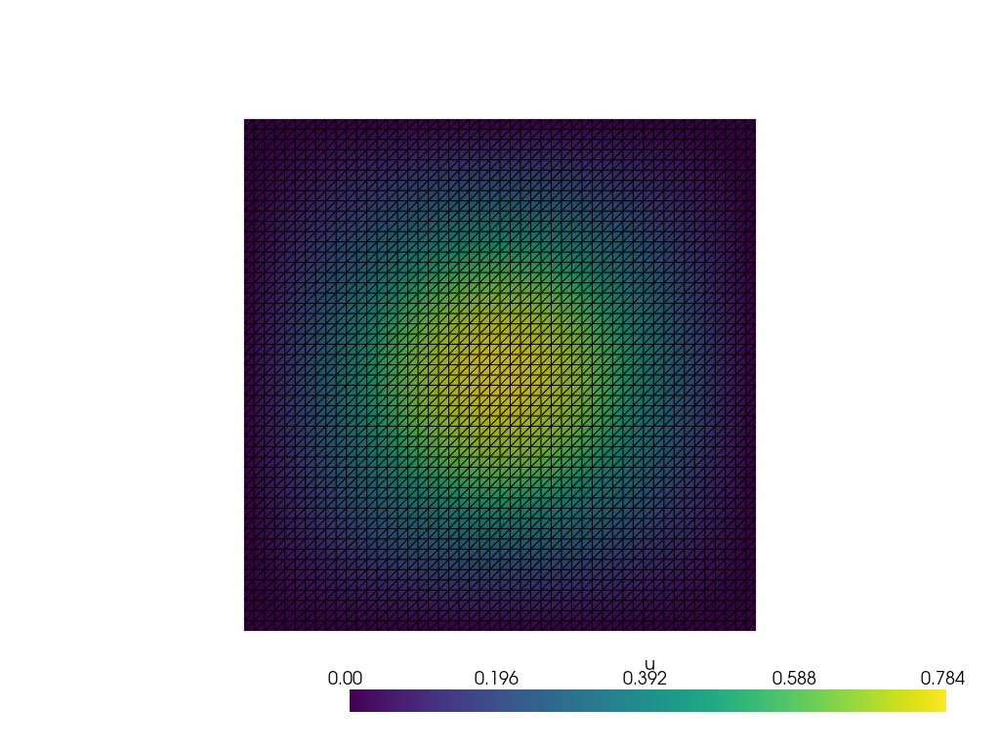

In [166]:
plotFuncList([u_list1[0]])

## Noiseless data

### Comparing $\alpha$

In [60]:
%autoreload
inv_problem = InverseProblem(problem)

In [61]:
alpha_array = [0,0.25,0.5,0.9]

In [62]:
ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_list1,f_list1,c,lmbda=2e3,lmbda_mult=1,alpha=0,n_iter=200)
ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_list1,f_list1,c,lmbda_mult="ME",alpha=0.25,n_iter=200,eta=0.5)
ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_list1,f_list1,c,lmbda_mult="ME",alpha=0.5,n_iter=200,eta=0.5)
ck4,kdelta4,err_array4,res_array4 = inv_problem.inLW(u_list1,f_list1,c,lmbda_mult="ME",alpha=0.9,n_iter=200,eta=0.5)

In [63]:
c0 = dolfinx.fem.Function(problem.V)
u0 = problem.directOperator(c0,f_list1)

In [64]:
res = dolfinx.fem.Function(V)
res.x.array[:] = u_list1[0].x.array - u0[0].x.array
directOperatorNorm([res])

0.0035243356134939214

In [65]:
err_array_list = [err_array1,err_array2,err_array3,err_array4]
res_array_list = [res_array1,res_array2,res_array3,res_array4]

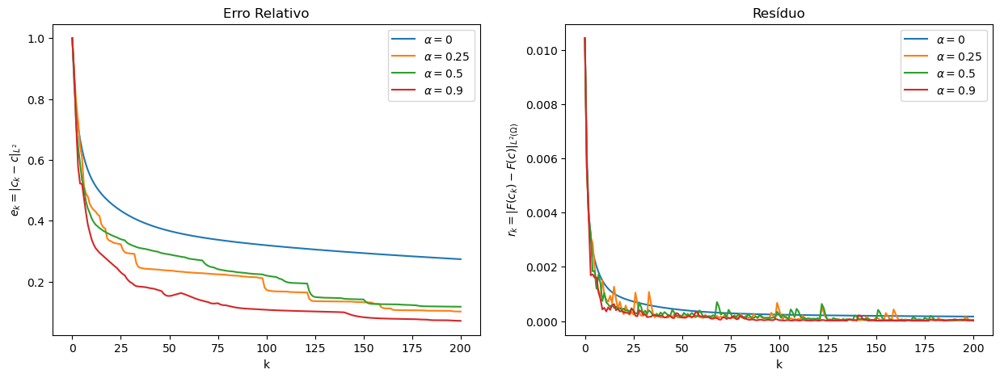

In [66]:
c_norm = funcSquareNorm(c)**0.5
u_norm = directOperatorNorm(u_list1)
fig, ax = plt.subplots(1,2, figsize=(15,5))
label_array = [f'$\\alpha = {alpha}$' for alpha in alpha_array]

for  err_array, res_array,label in zip(err_array_list,res_array_list,label_array):
  ax[0].plot(err_array/c_norm,label=label)
  ax[1].plot(res_array/u_norm,label=label)
  # if kdelta!=None and kdelta!=-1:
  #   ax[0].plot([kdelta],[err_array[kdelta]/c_norm],linestyle ='',marker='.',markersize=5,label='$k_\delta$')
  

ax[0].set_title("Erro Relativo")
ax[0].set_ylabel("$e_k = \|c_k - c\|_{L^2}$")
ax[0].set_xlabel("k")
ax[0].legend()

ax[1].set_title("Resíduo")
ax[1].set_ylabel("$r_k = \|F(c_k) - F(c)\|_{L^2(\Omega)}$")
ax[1].set_xlabel("k")
ax[1].legend()
plt.show()

- testar alpha proximo de 0, depois maior ou igual a 1
- alterar a constante do cone
- testar com os níveis de ruídos

In [174]:
err_list=[]
for ck in [ck1,ck2,ck3,ck4]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)



Error graphs:

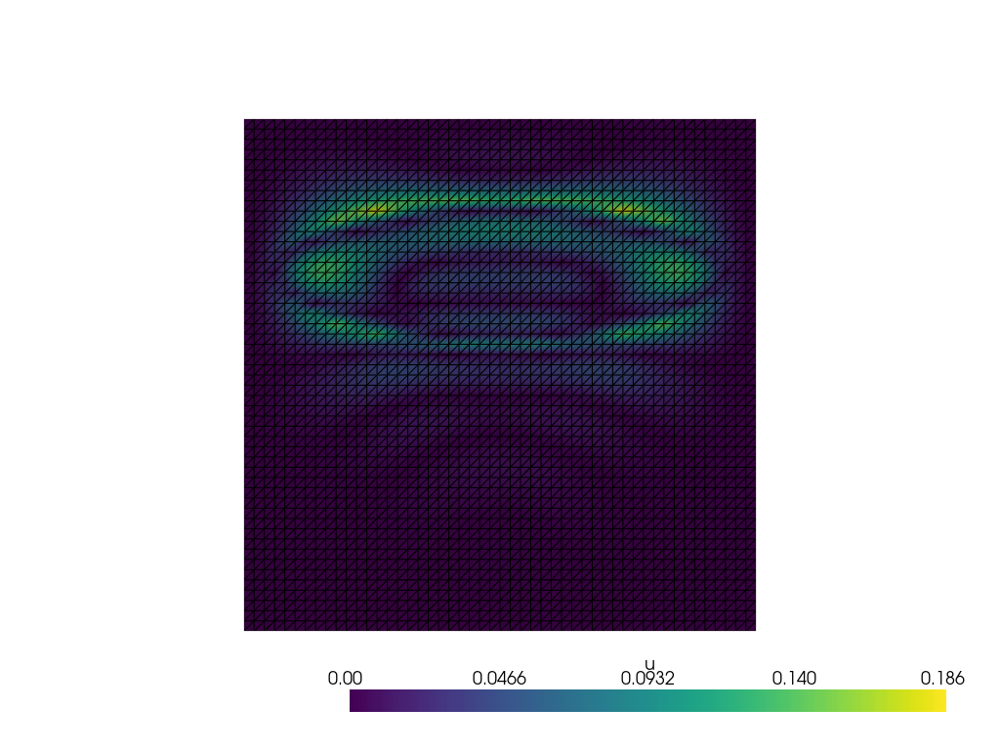

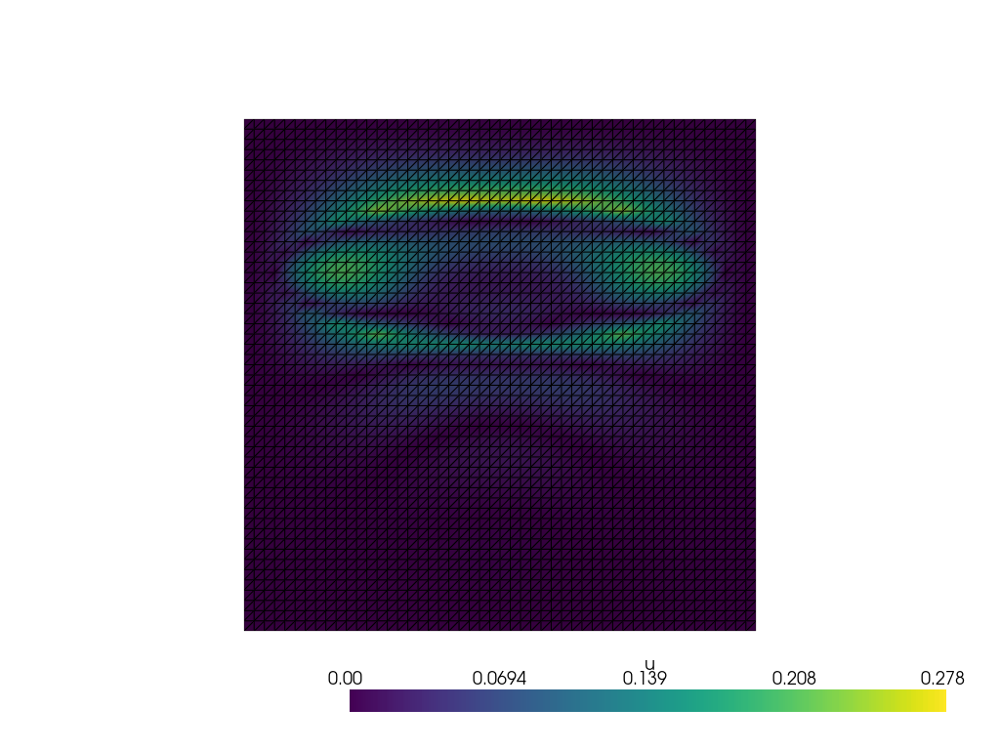

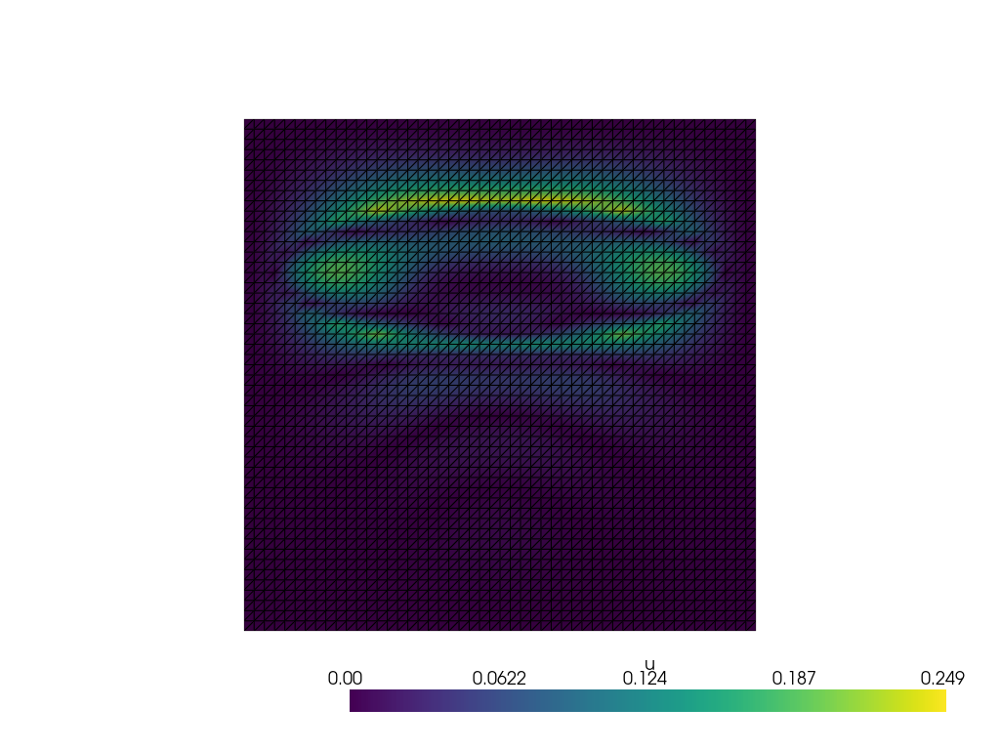

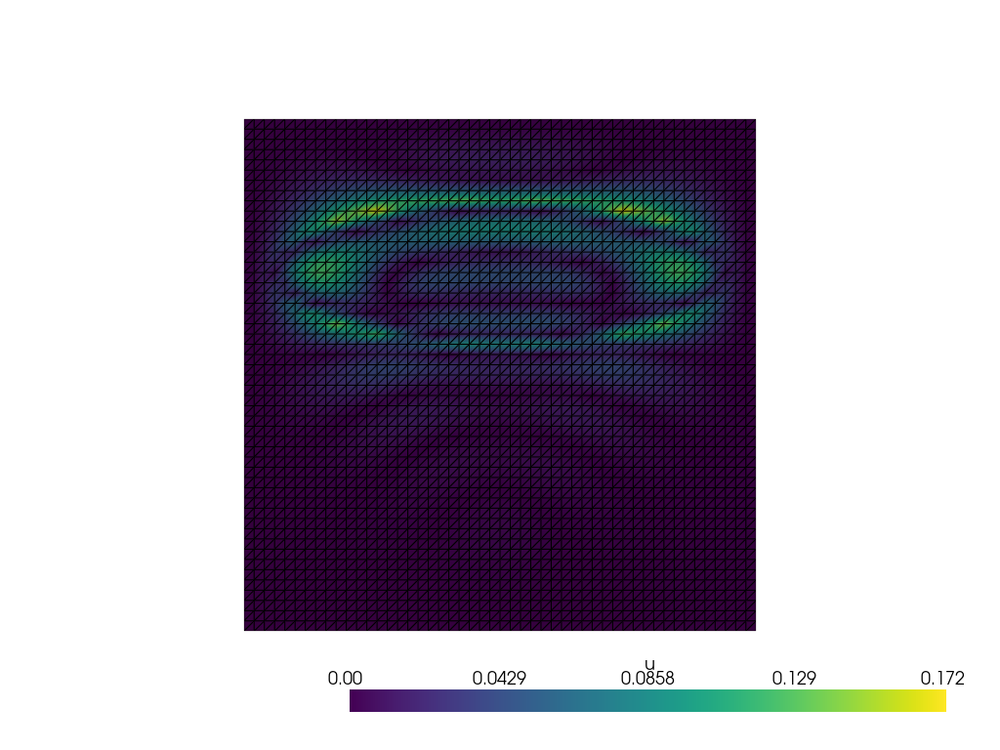

In [175]:
for err in err_list:
    plotFuncList([err])

Solution graphs

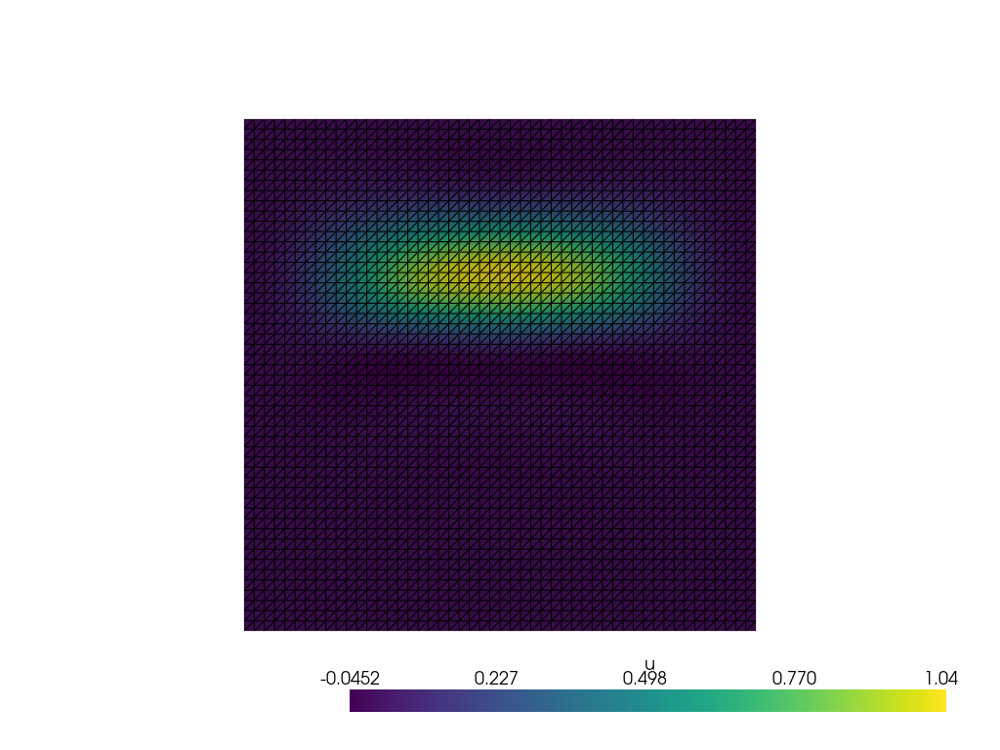

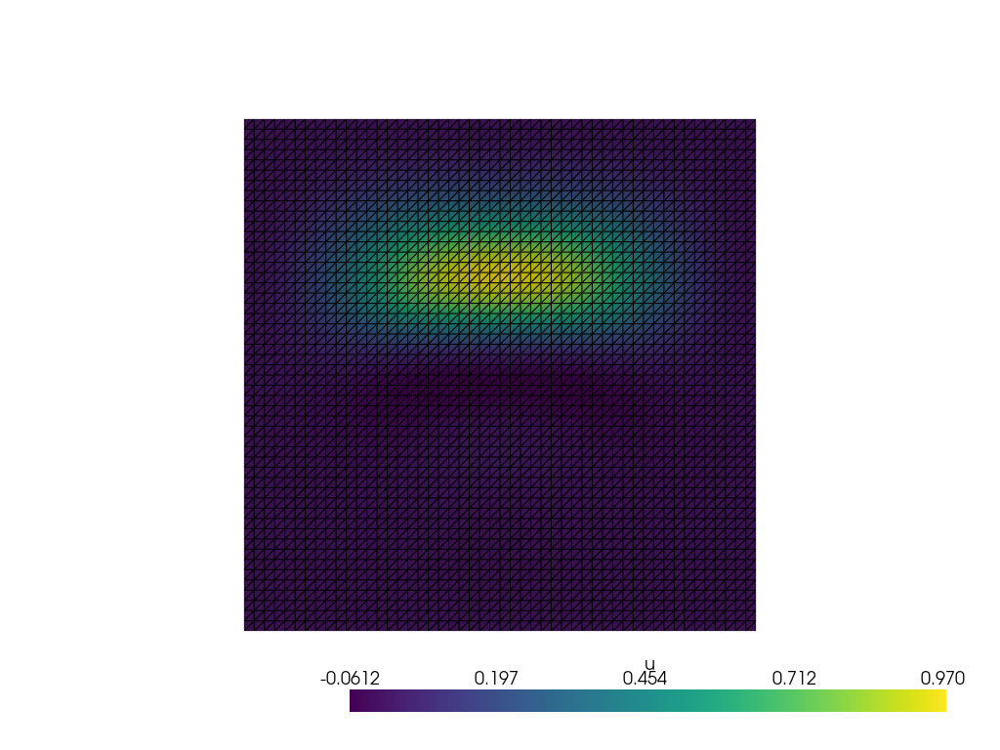

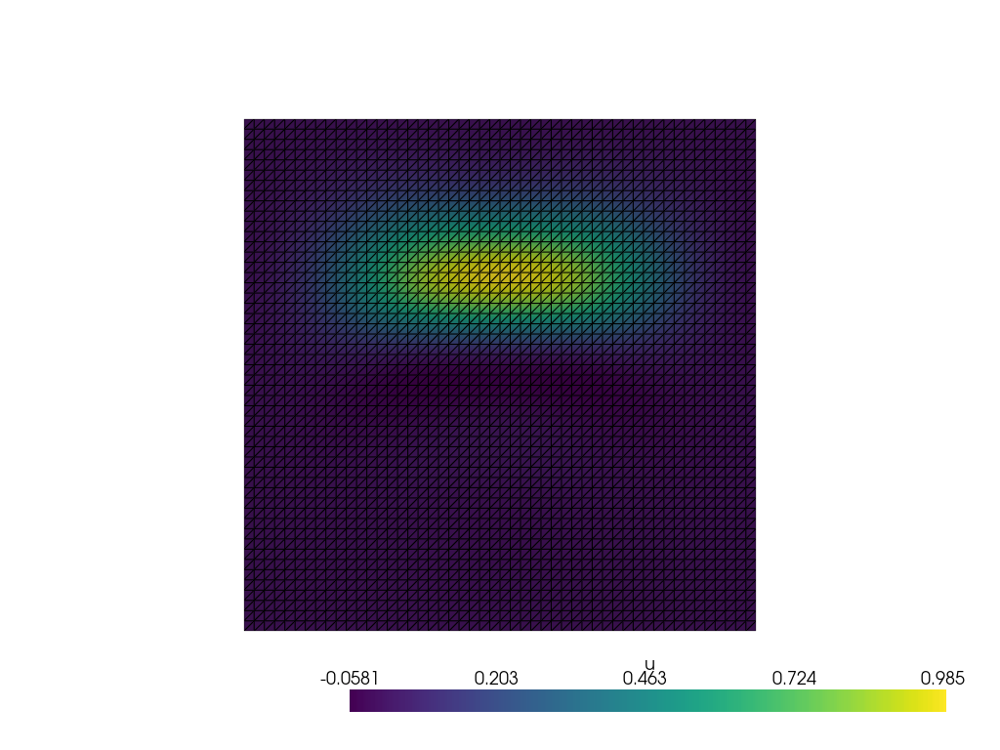

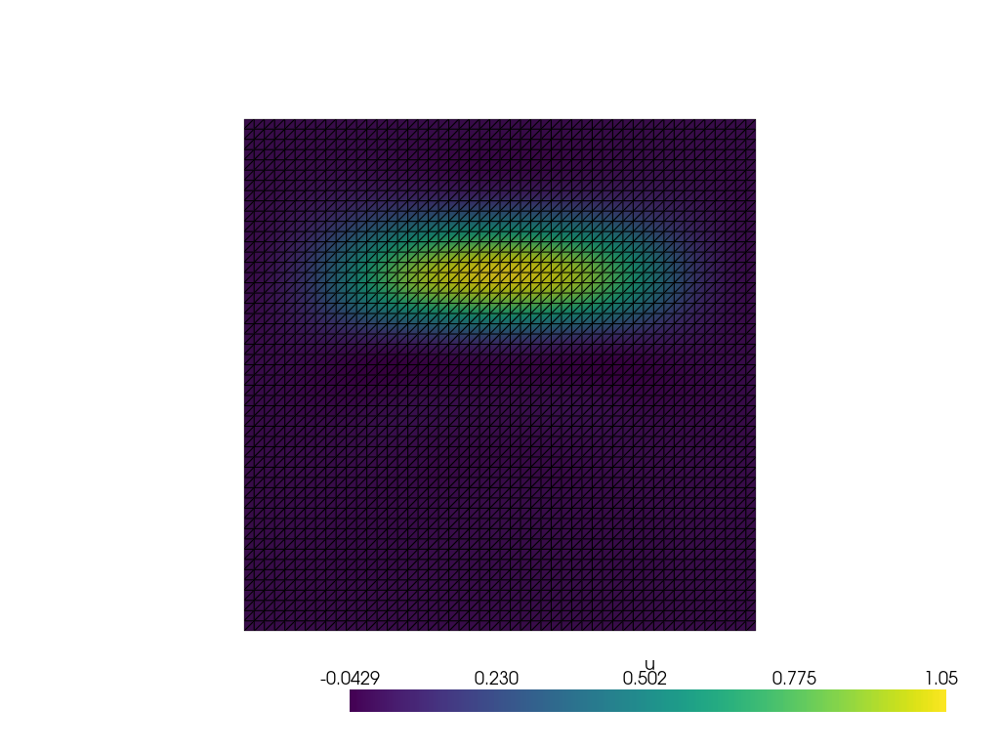

In [176]:
plotFuncList([ck1])
plotFuncList([ck2])
plotFuncList([ck3])
plotFuncList([ck4])

## Noised data - Fixed noise

### $\delta = 1\%$

In [177]:
%autoreload
inv_problem = InverseProblem(problem)

In [178]:
delta_per = 1
u_delta_list = inv_problem.addNoise(u_list1,delta_per)
# delta = inv_problem.computeDelta(u_list1,u_delta_list)

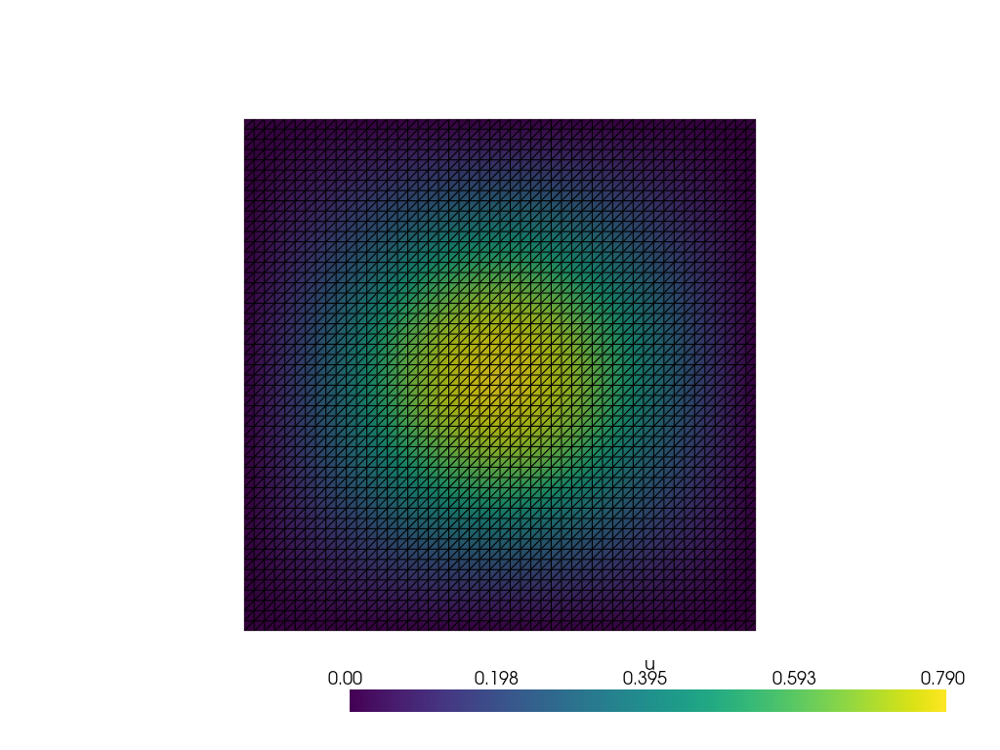

In [179]:
plotFuncList(u_delta_list)

### Comparing $\alpha$

In [180]:
%autoreload
inv_problem = InverseProblem(problem)

In [181]:
alpha_array = [0,0.25,0.5,0.9]

In [182]:
ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0,n_iter=100)
ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.25,n_iter=100)
ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.5,n_iter=100)
ck4,kdelta4,err_array4,res_array4 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.9,n_iter=100)

In [183]:
err_array_list = [err_array1,err_array2,err_array3,err_array4]
res_array_list = [res_array1,res_array2,res_array3,res_array4]
kdelta_list = [kdelta1,kdelta2,kdelta3,kdelta4]

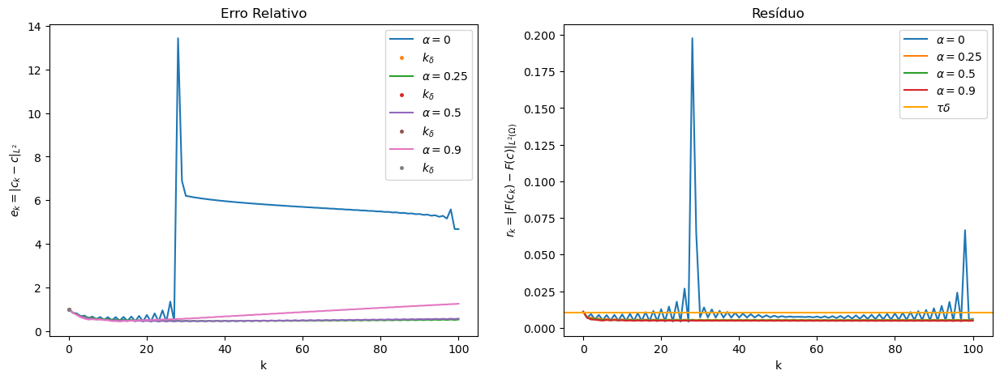

In [184]:
c_norm = funcSquareNorm(c)**0.5
u_norm = directOperatorNorm(u_delta_list)
fig, ax = plt.subplots(1,2, figsize=(15,5))
label_array = [f'$\\alpha = {alpha}$' for alpha in alpha_array]

for  err_array, res_array,label,kdelta in zip(err_array_list,res_array_list,label_array,kdelta_list):
  ax[0].plot(err_array/c_norm,label=label)
  ax[1].plot(res_array/u_norm,label=label)
  if kdelta!=None and kdelta!=-1:
    ax[0].plot([kdelta],[err_array[kdelta]/c_norm],linestyle ='',marker='.',markersize=5,label='$k_\delta$')
  

ax[0].set_title("Erro Relativo")
ax[0].set_ylabel("$e_k = \|c_k - c\|_{L^2}$")
ax[0].set_xlabel("k")
ax[0].legend()

if delta_per!=None:
  ax[1].axhline(y=(1.01*(delta_per/100)),label='$\\tau \delta$',color='orange')
ax[1].set_title("Resíduo")
ax[1].set_ylabel("$r_k = \|F(c_k) - F(c)\|_{L^2(\Omega)}$")
ax[1].set_xlabel("k")
ax[1].legend()
plt.show()

In [185]:
0.01*u_norm

0.003379881176264018

In [186]:
print(kdelta_list)

[0, 0, 0, 0]


In [187]:
err_list=[]
for ck in [ck1,ck2,ck3,ck4]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)

Error graphs:

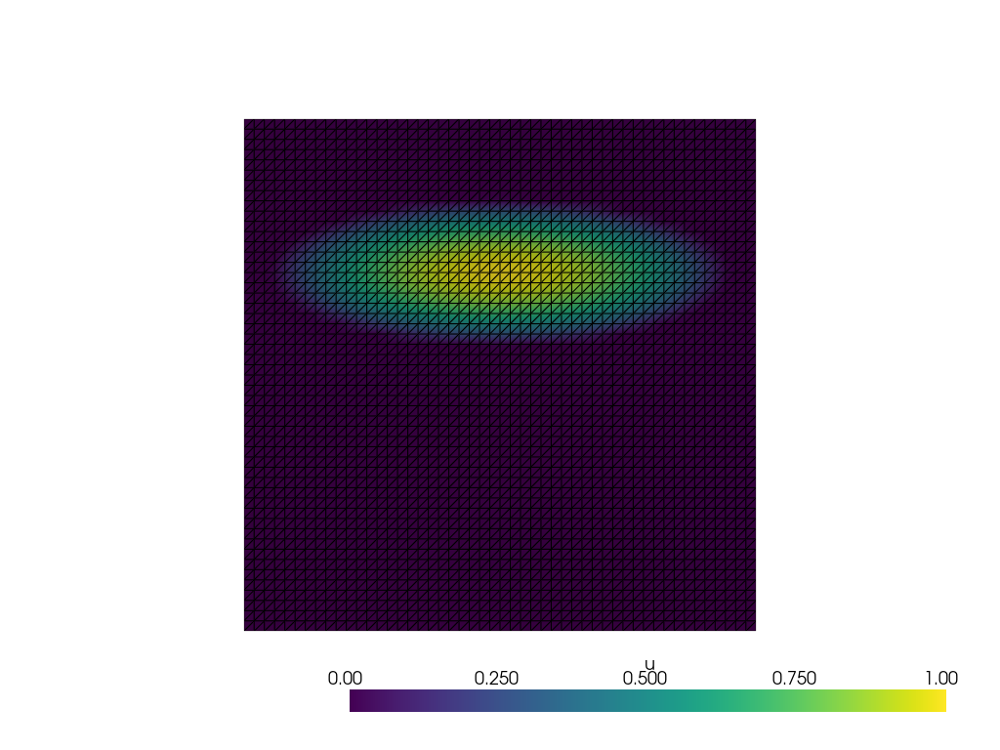

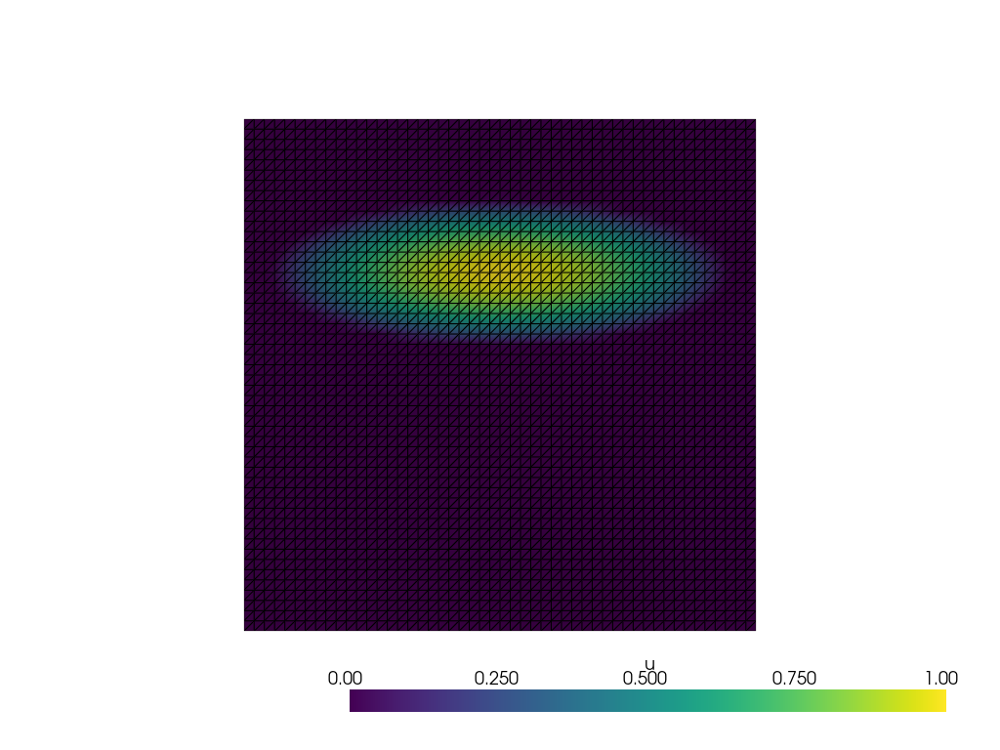

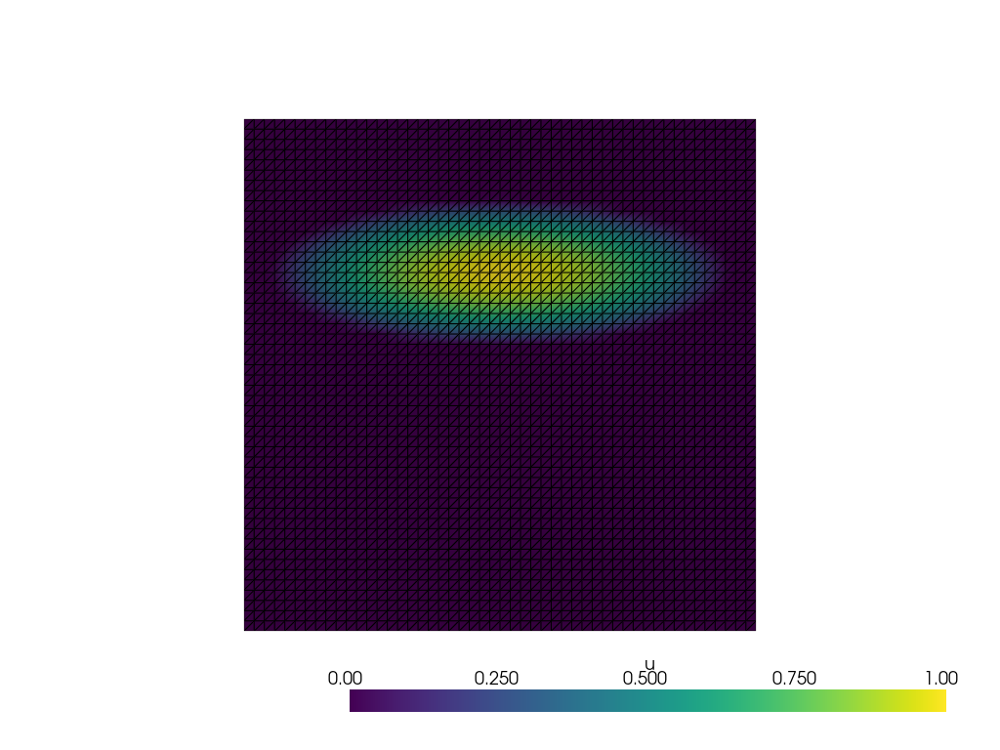

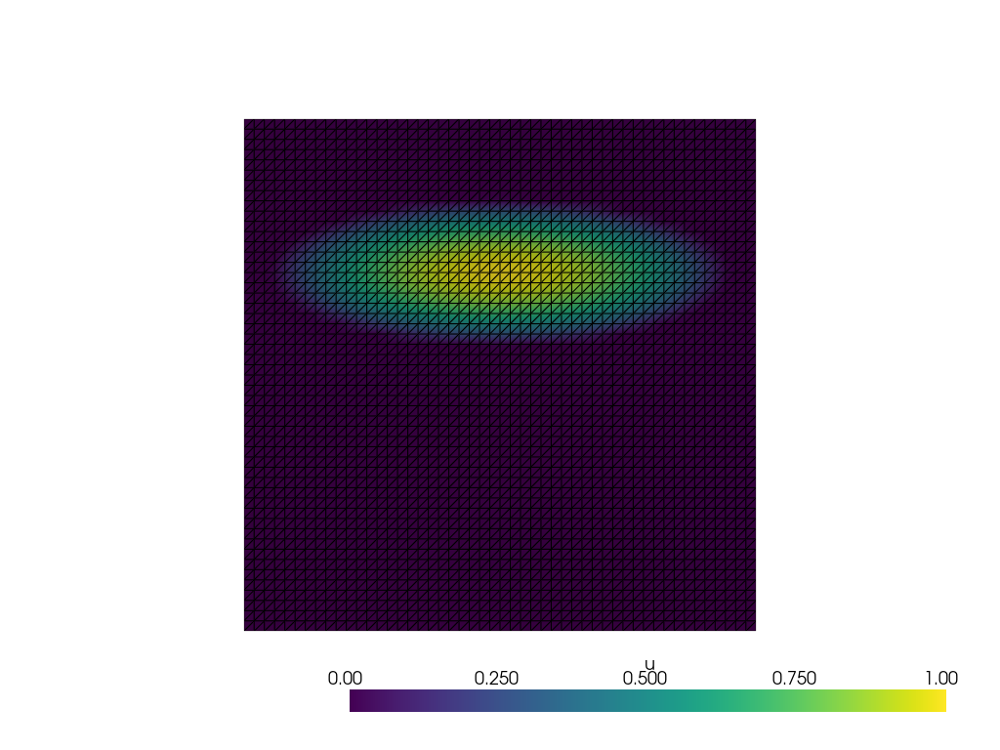

In [188]:
for err in err_list:
    plotFuncList([err])

Solution graphs

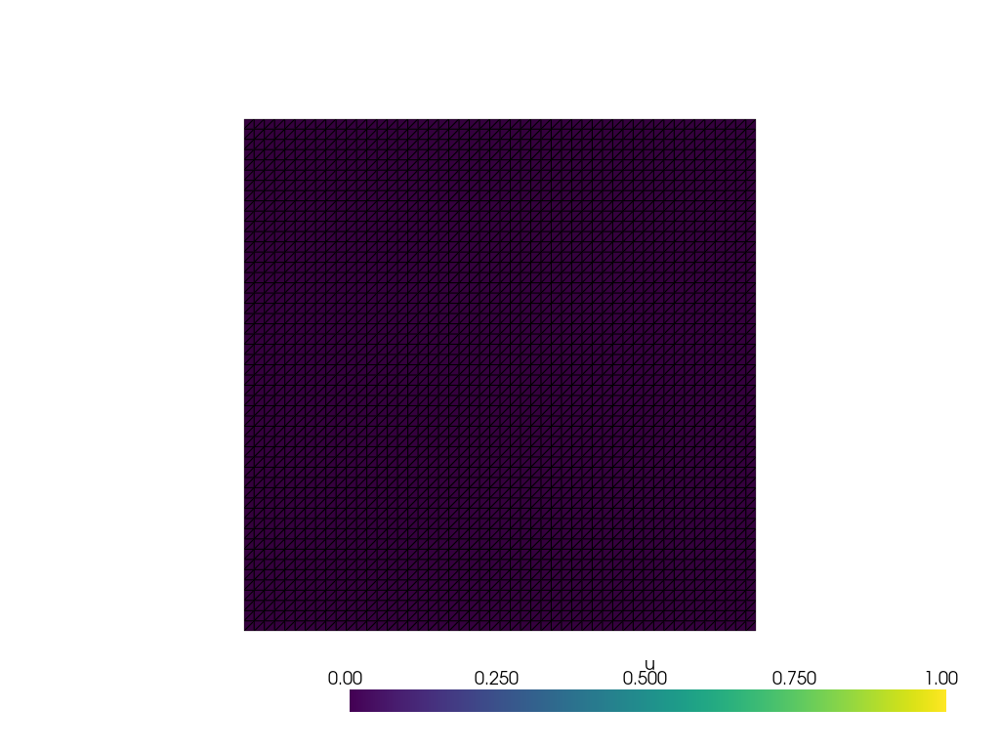

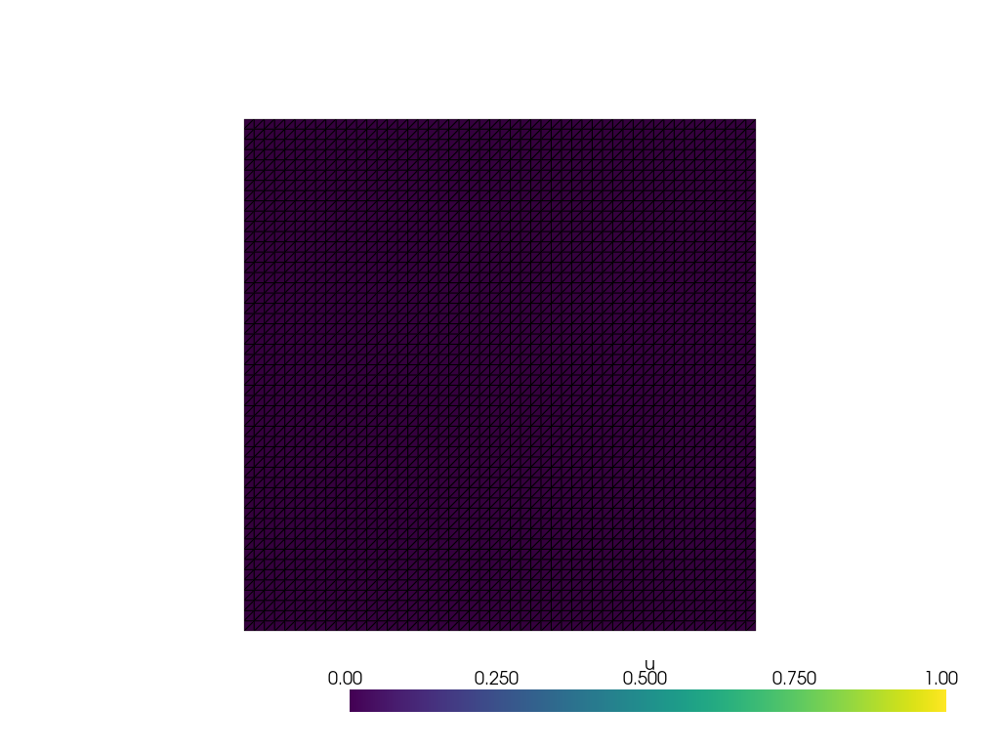

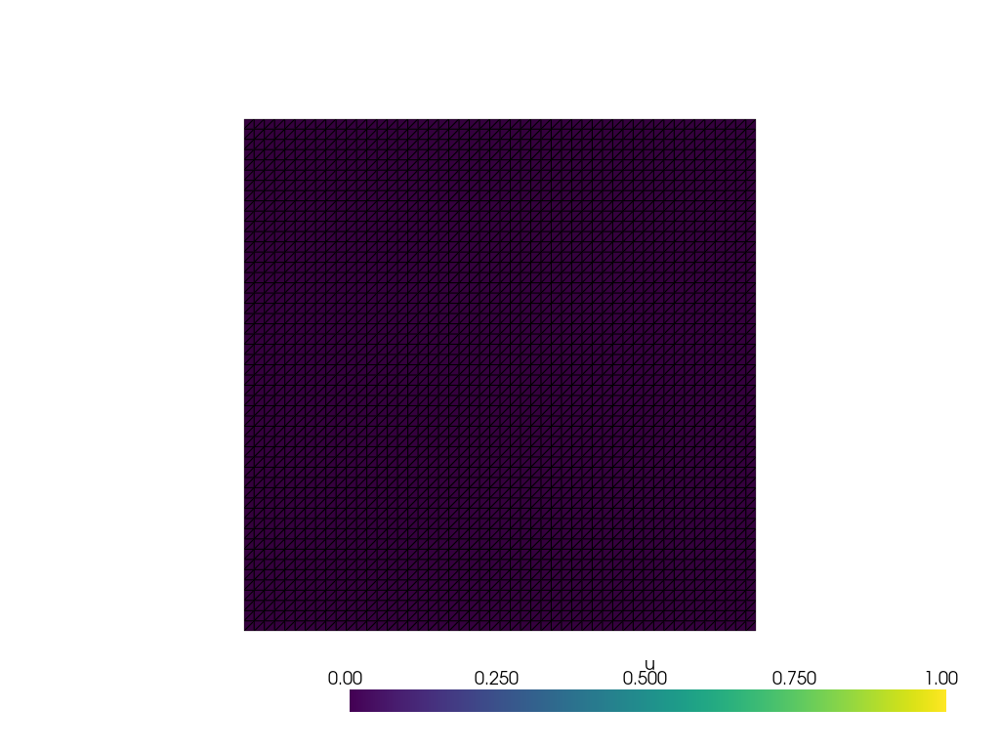

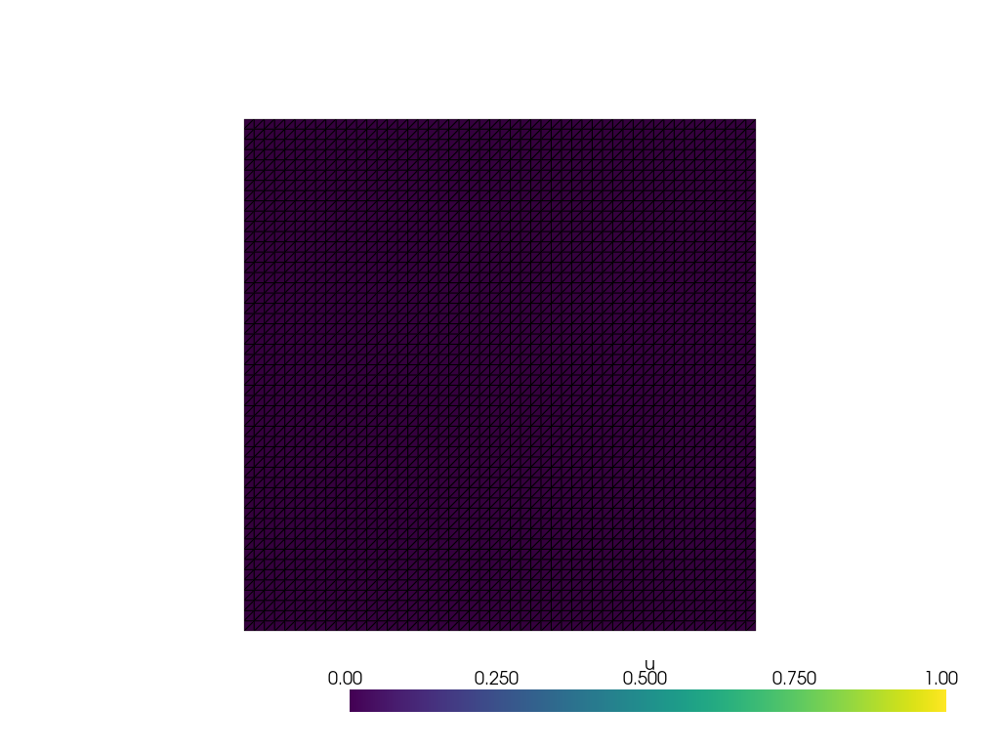

In [189]:
plotFuncList([ck1])
plotFuncList([ck2])
plotFuncList([ck3])
plotFuncList([ck4])

### $\delta = 0.1\%$

In [190]:
%autoreload
inv_problem = InverseProblem(problem)

In [191]:
delta_per = 0.1
u_delta_list = inv_problem.addNoise(u_list1,delta_per)
# delta = inv_problem.computeDelta(u_list1,u_delta_list)

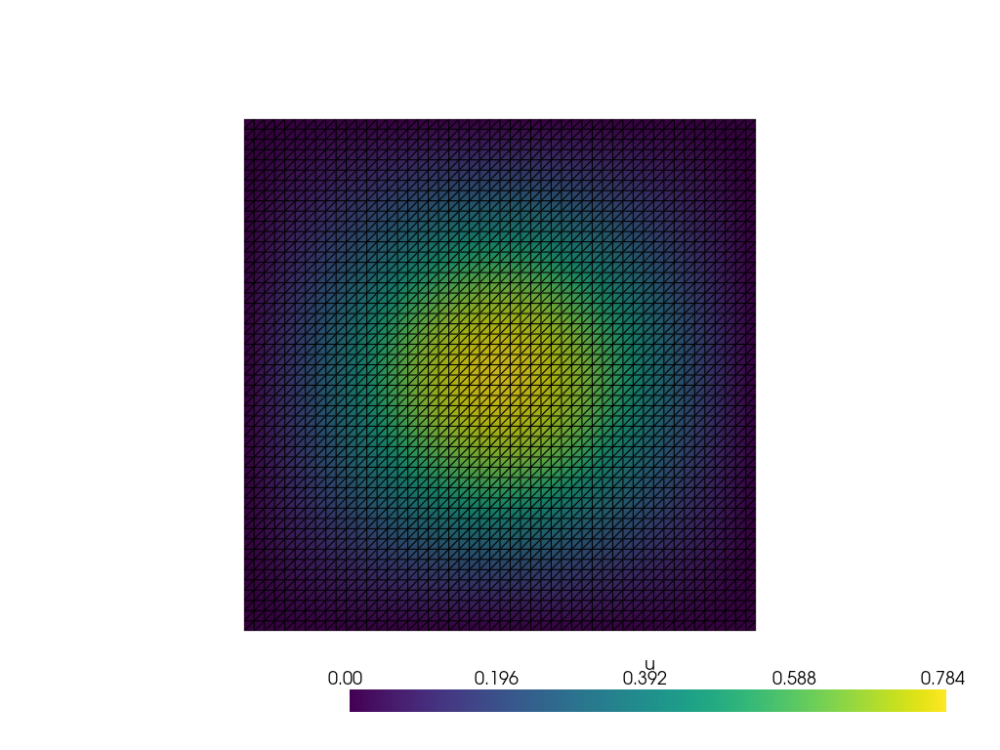

In [192]:
plotFuncList(u_delta_list)

### Comparing $\alpha$

In [215]:
%autoreload
inv_problem = InverseProblem(problem)

In [216]:
alpha_array = [0,0.25,0.5,0.9]

In [217]:
ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0,n_iter=100)
ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.25,n_iter=100)
ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.5,n_iter=100)
ck4,kdelta4,err_array4,res_array4 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.9,n_iter=100)

In [218]:
err_array_list = [err_array1,err_array2,err_array3,err_array4]
res_array_list = [res_array1,res_array2,res_array3,res_array4]
kdelta_list = [kdelta1,kdelta2,kdelta3,kdelta4]

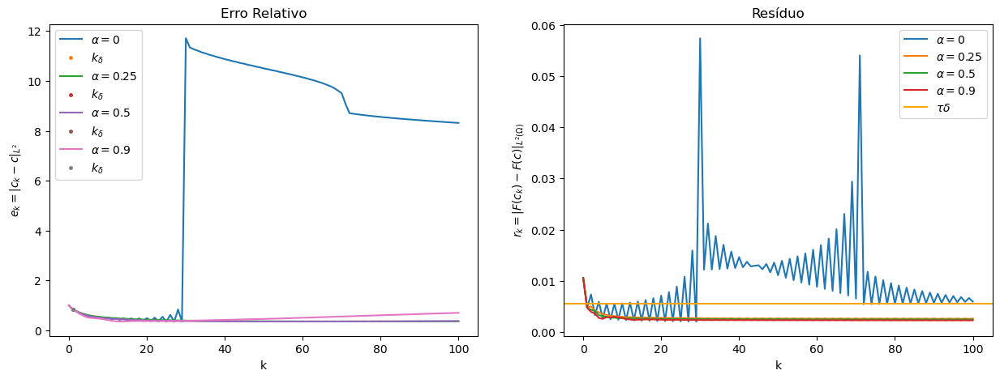

In [219]:
c_norm = funcSquareNorm(c)**0.5
u_norm = directOperatorNorm(u_delta_list)
fig, ax = plt.subplots(1,2, figsize=(15,5))
label_array = [f'$\\alpha = {alpha}$' for alpha in alpha_array]

for  err_array, res_array,label,kdelta in zip(err_array_list,res_array_list,label_array,kdelta_list):
  ax[0].plot(err_array/c_norm,label=label)
  ax[1].plot(res_array/u_norm,label=label)
  if kdelta!=None and kdelta!=-1:
    ax[0].plot([kdelta],[err_array[kdelta]/c_norm],linestyle ='',marker='.',markersize=5,label='$k_\delta$')
  

ax[0].set_title("Erro Relativo")
ax[0].set_ylabel("$e_k = \|c_k - c\|_{L^2}$")
ax[0].set_xlabel("k")
ax[0].legend()

if delta_per!=None:
  ax[1].axhline(y=(1.1*(delta_per/100)),label='$\\tau \delta$',color='orange')
ax[1].set_title("Resíduo")
ax[1].set_ylabel("$r_k = \|F(c_k) - F(c)\|_{L^2(\Omega)}$")
ax[1].set_xlabel("k")
ax[1].legend()
plt.show()

In [198]:
print(kdelta_list)

[9, 17, 12, 11]


In [199]:
err_list=[]
for ck in [ck1,ck2,ck3,ck4]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)

Error graphs:

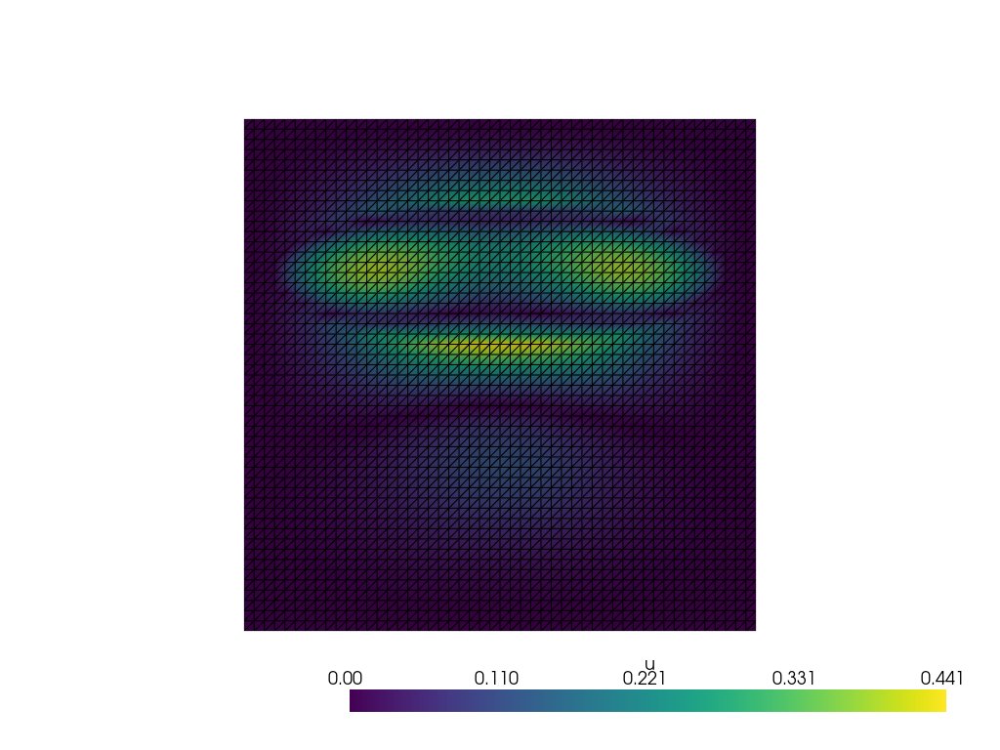

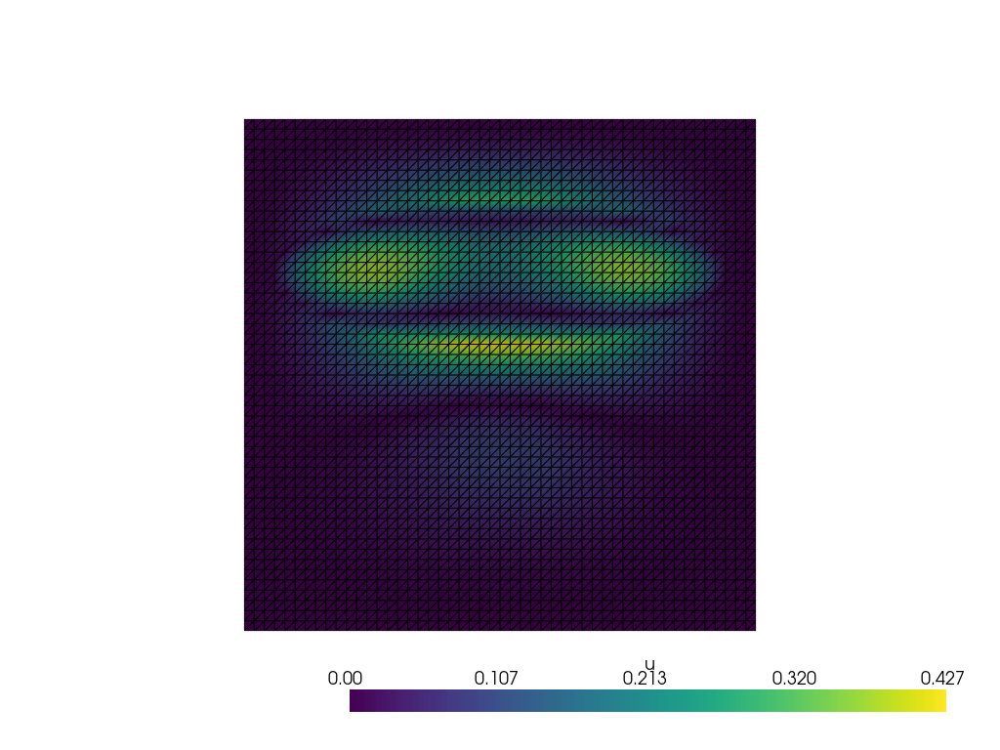

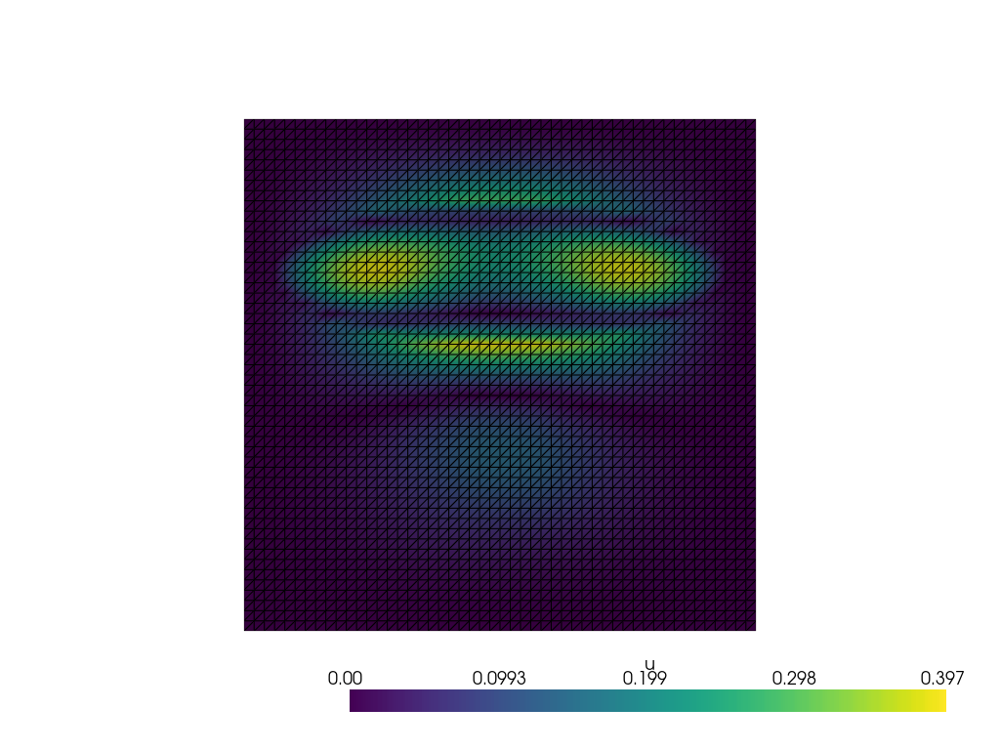

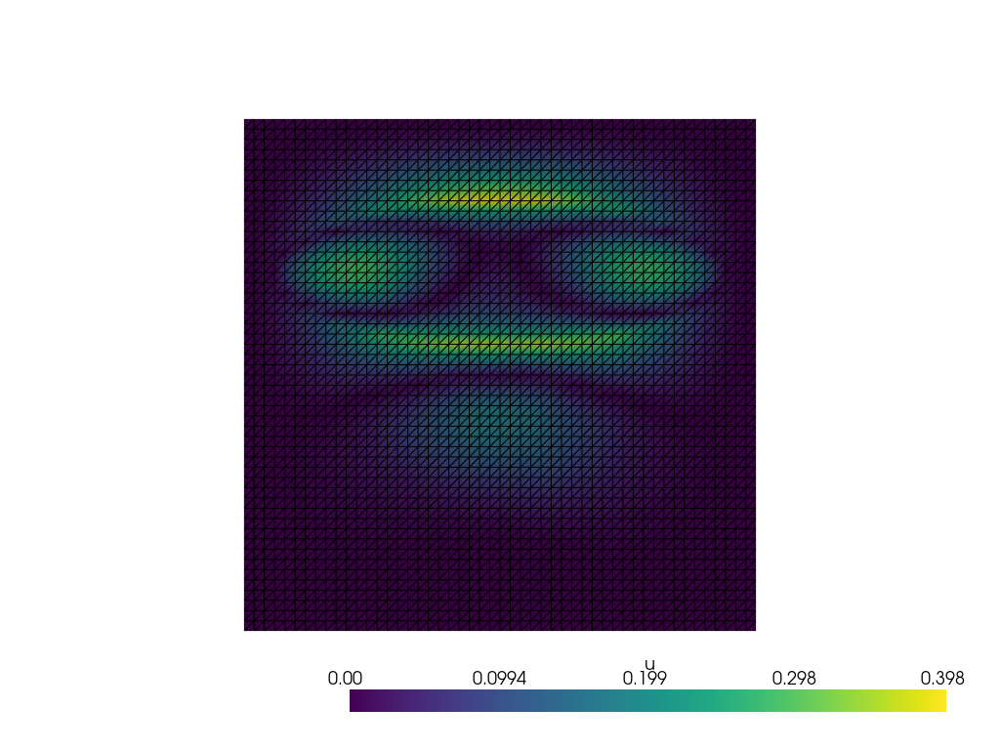

In [200]:
for err in err_list:
    plotFuncList([err])

Solution graphs

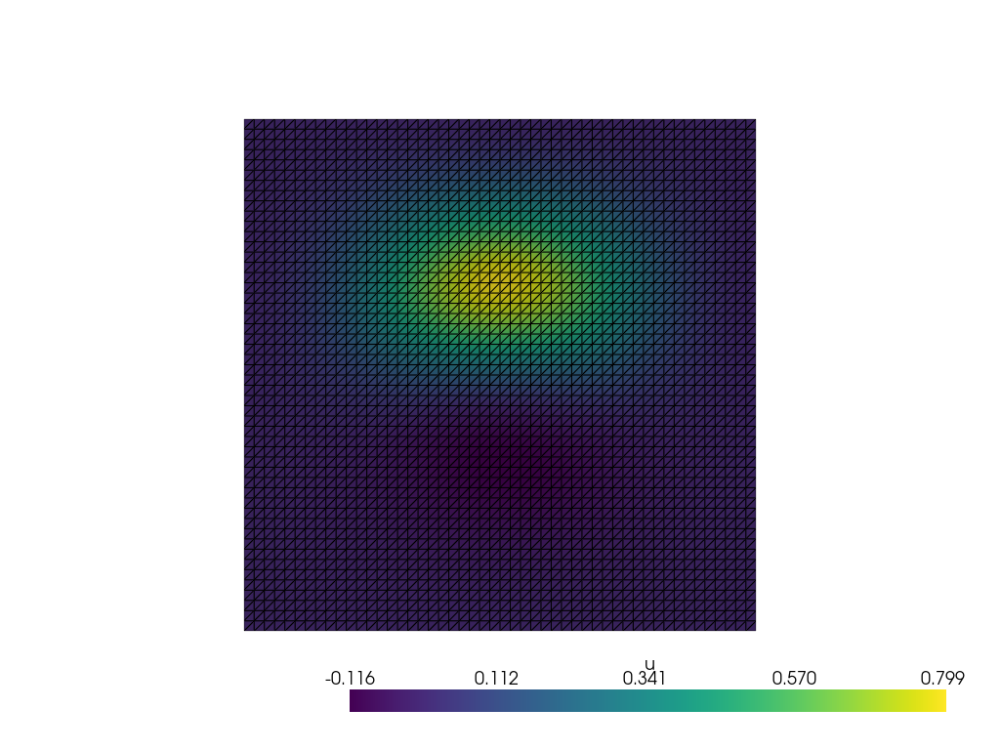

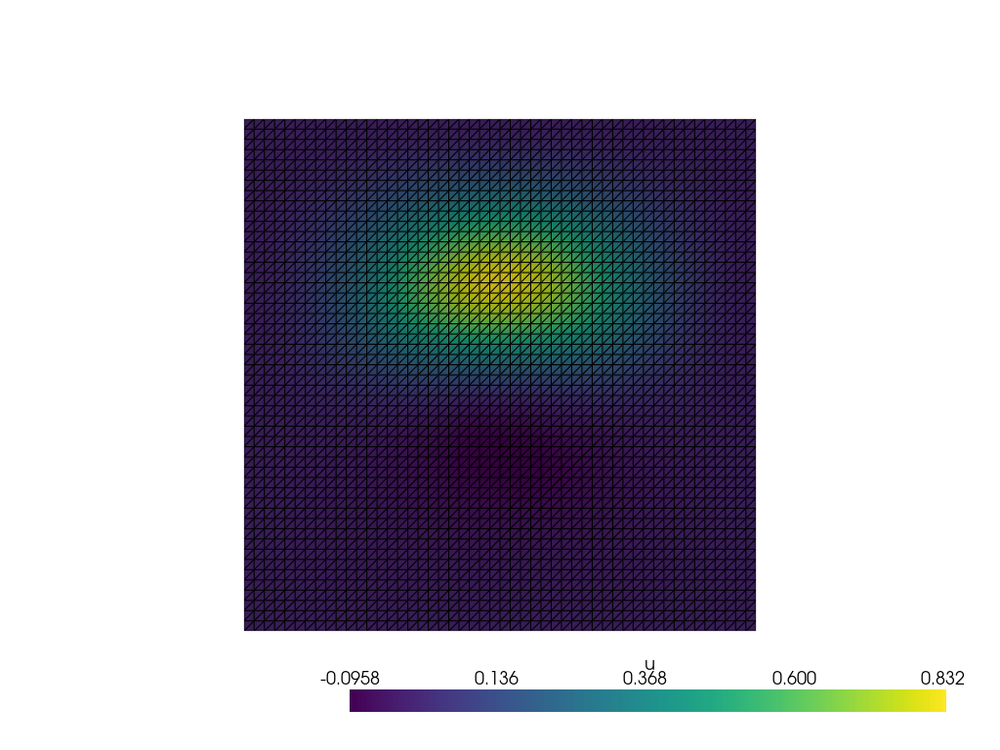

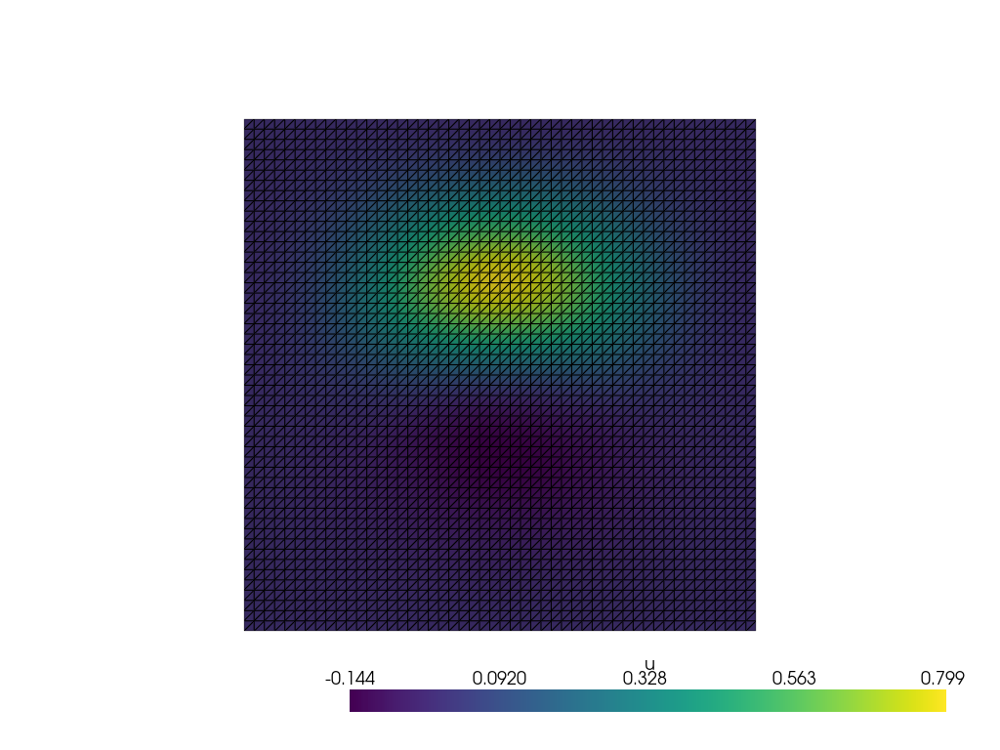

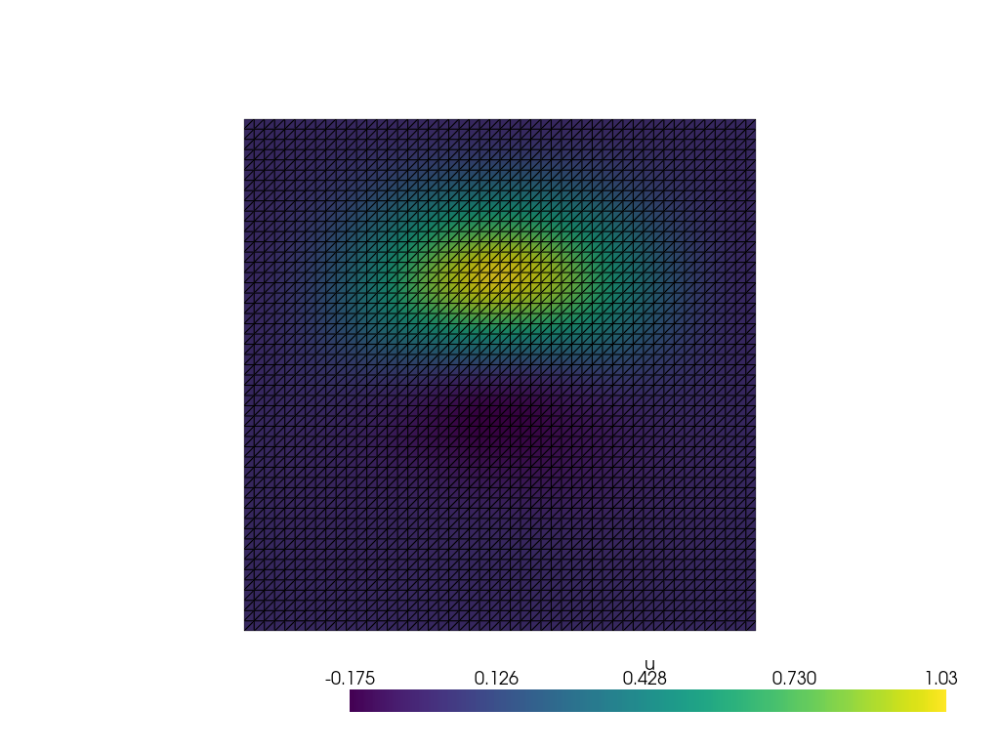

In [201]:
plotFuncList([ck1])
plotFuncList([ck2])
plotFuncList([ck3])
plotFuncList([ck4])

### $\delta = 0.5\%$

In [202]:
%autoreload
inv_problem = InverseProblem(problem)

In [203]:
delta_per = 0.5
u_delta_list = inv_problem.addNoise(u_list1,delta_per)
# delta = inv_problem.computeDelta(u_list1,u_delta_list)

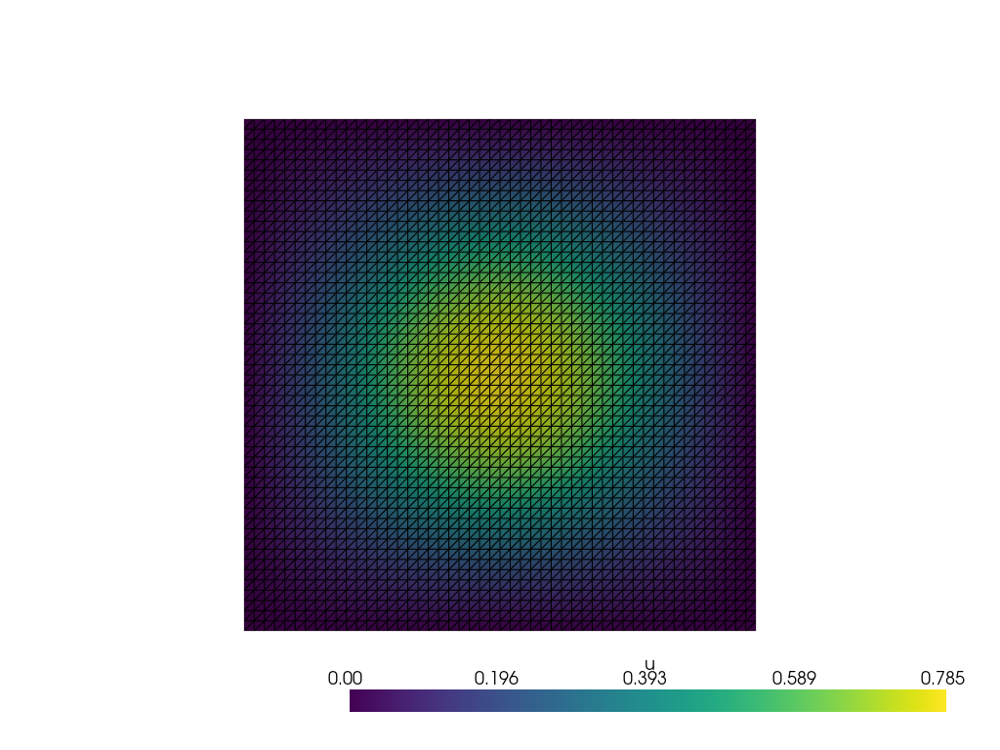

In [204]:
plotFuncList(u_delta_list)

### Comparing $\alpha$

In [205]:
%autoreload
inv_problem = InverseProblem(problem)

In [206]:
alpha_array = [0,0.25,0.5,0.9]

In [207]:
ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0,n_iter=100)
ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.25,n_iter=100)
ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.5,n_iter=100)
ck4,kdelta4,err_array4,res_array4 = inv_problem.inLW(u_delta_list,f_list1,c,lmbda_mult="ME",delta=delta_per,tau=1.1,alpha=0.9,n_iter=100)

In [208]:
err_array_list = [err_array1,err_array2,err_array3,err_array4]
res_array_list = [res_array1,res_array2,res_array3,res_array4]
kdelta_list = [kdelta1,kdelta2,kdelta3,kdelta4]

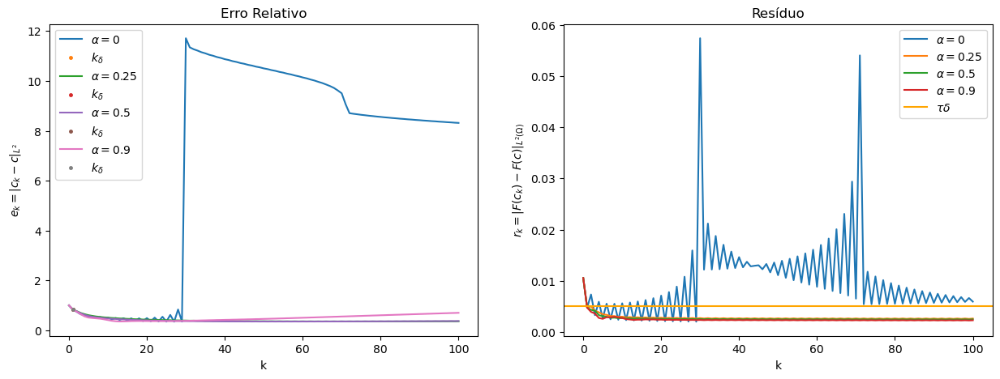

In [209]:
c_norm = funcSquareNorm(c)**0.5
u_norm = directOperatorNorm(u_delta_list)
fig, ax = plt.subplots(1,2, figsize=(15,5))
label_array = [f'$\\alpha = {alpha}$' for alpha in alpha_array]

for  err_array, res_array,label,kdelta in zip(err_array_list,res_array_list,label_array,kdelta_list):
  ax[0].plot(err_array/c_norm,label=label)
  ax[1].plot(res_array/u_norm,label=label)
  if kdelta!=None and kdelta!=-1:
    ax[0].plot([kdelta],[err_array[kdelta]/c_norm],linestyle ='',marker='.',markersize=5,label='$k_\delta$')
  

ax[0].set_title("Erro Relativo")
ax[0].set_ylabel("$e_k = \|c_k - c\|_{L^2}$")
ax[0].set_xlabel("k")
ax[0].legend()

if delta_per!=None:
  ax[1].axhline(y=(1.01*(delta_per/100)),label='$\\tau \delta$',color='orange')
ax[1].set_title("Resíduo")
ax[1].set_ylabel("$r_k = \|F(c_k) - F(c)\|_{L^2(\Omega)}$")
ax[1].set_xlabel("k")
ax[1].legend()
plt.show()

In [210]:
print(kdelta_list)

[1, 1, 1, 1]


In [211]:
err_list=[]
for ck in [ck1,ck2,ck3,ck4]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)

Error graphs:

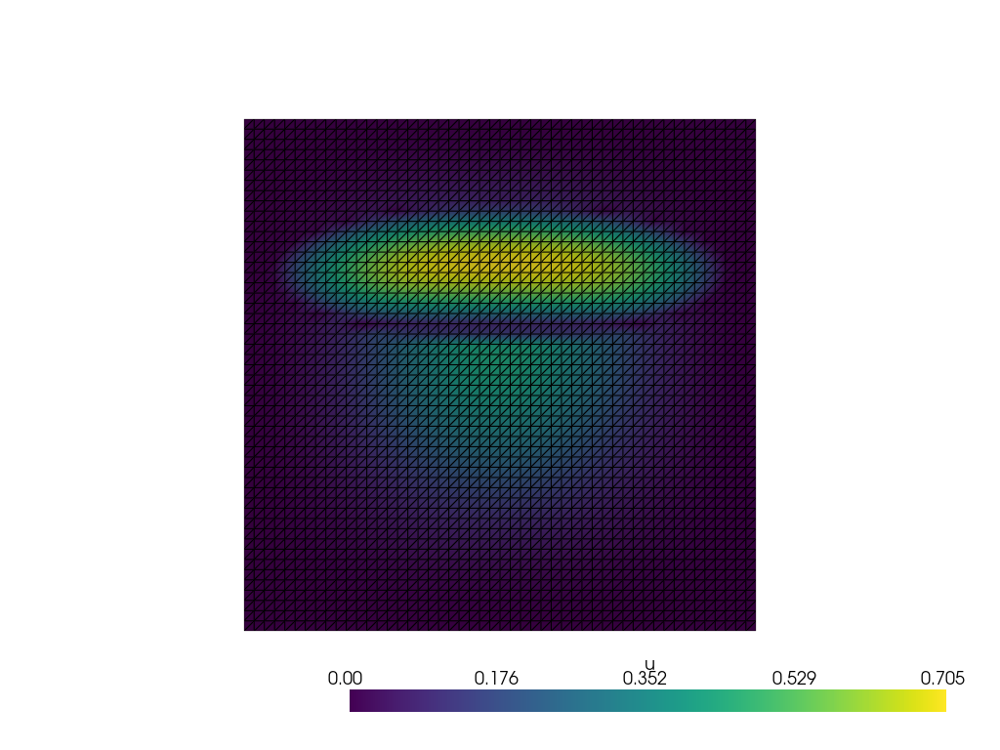

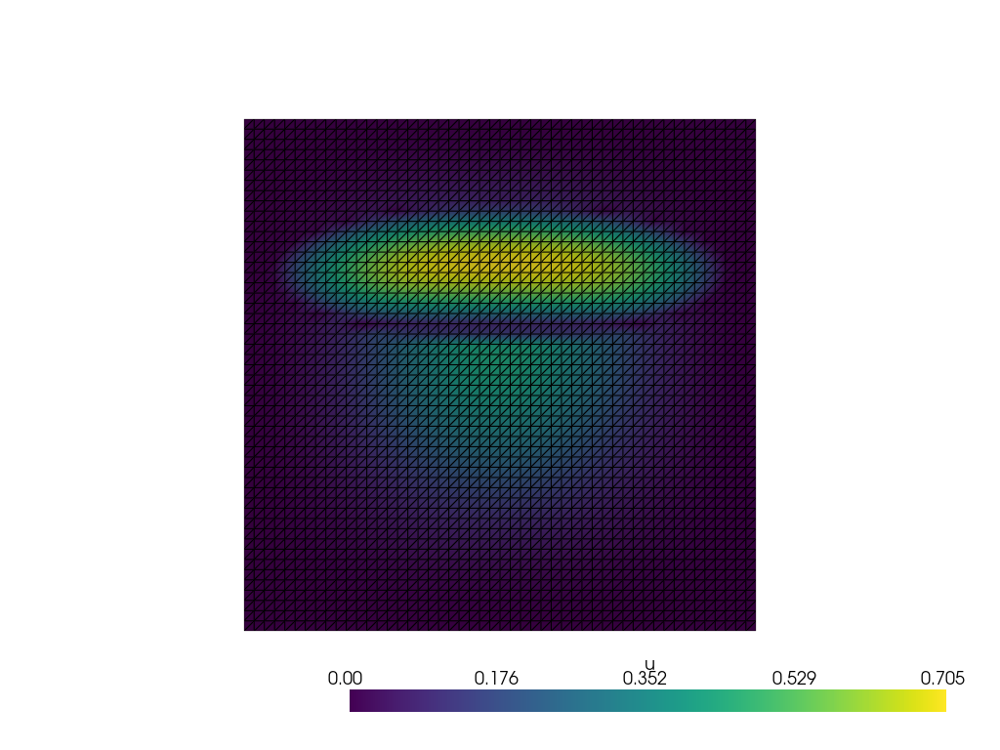

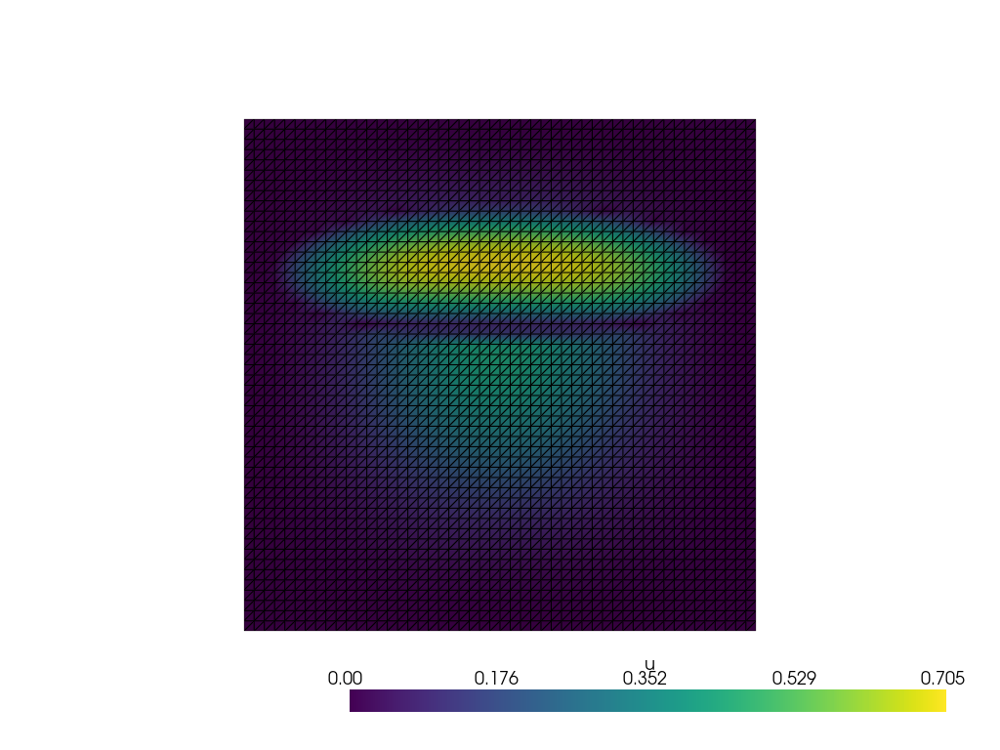

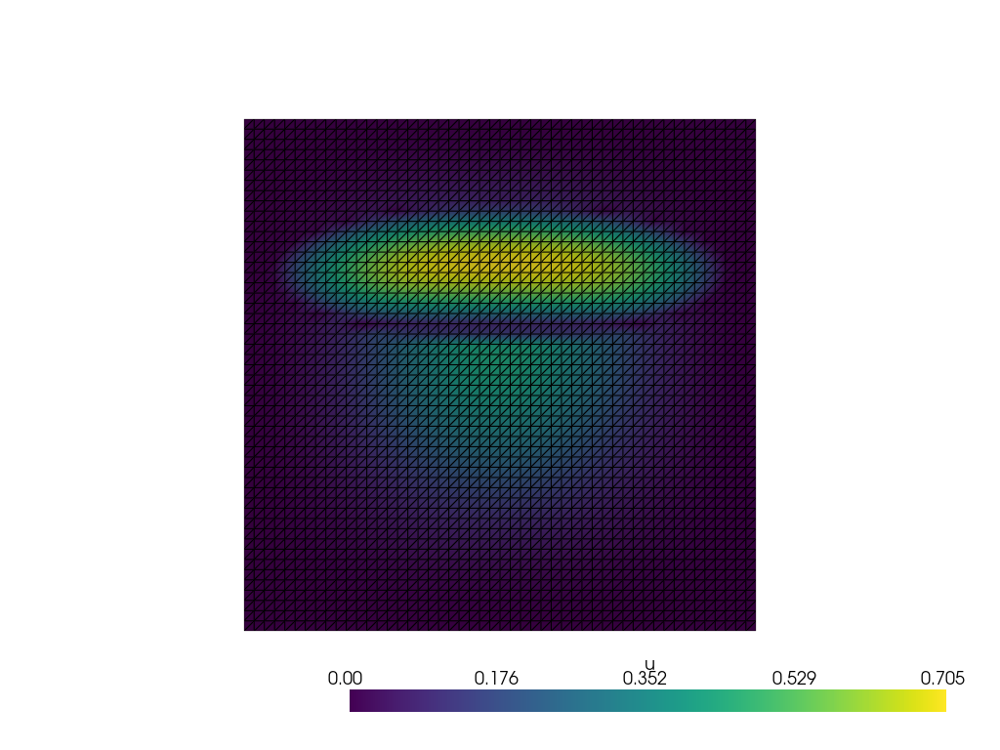

In [212]:
for err in err_list:
    plotFuncList([err])

Solution graphs

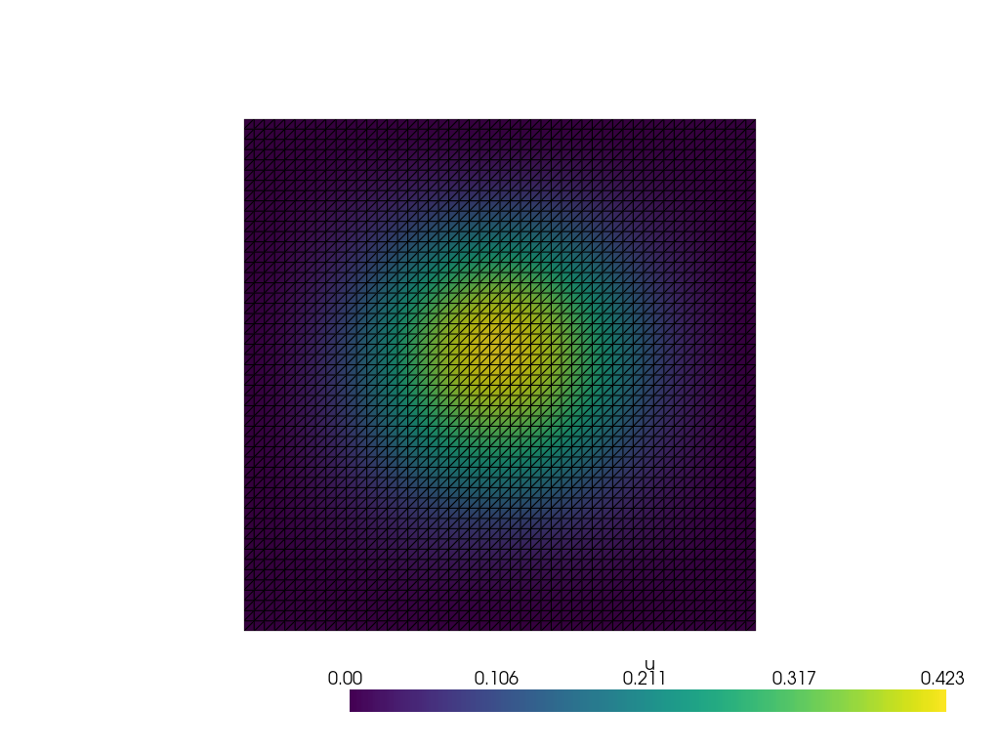

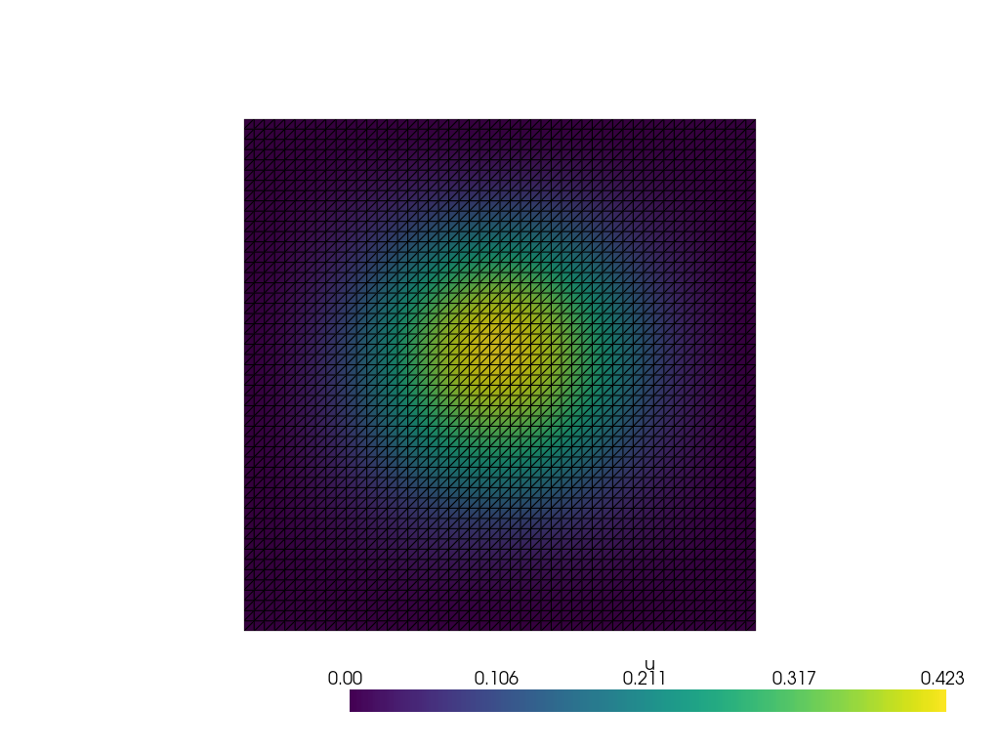

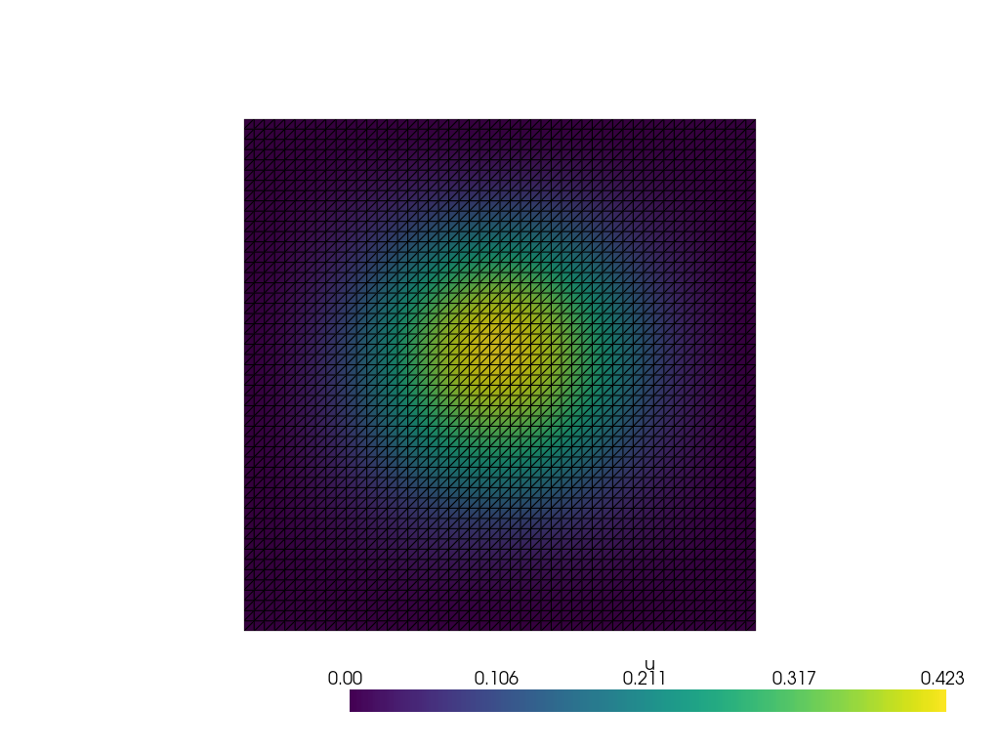

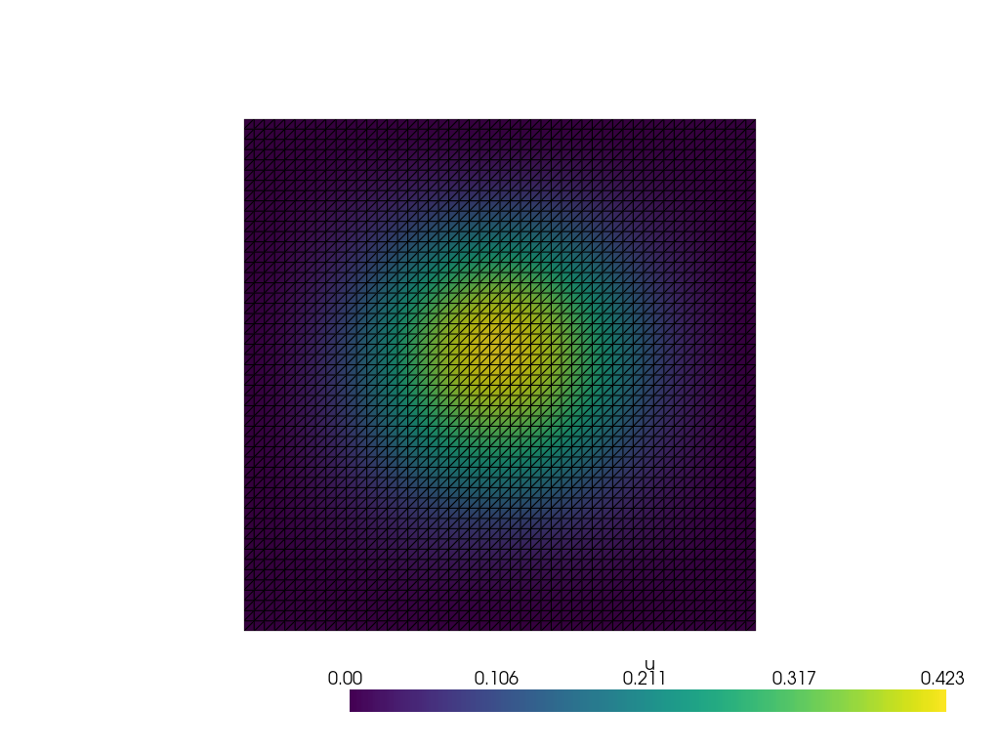

In [213]:
plotFuncList([ck1])
plotFuncList([ck2])
plotFuncList([ck3])
plotFuncList([ck4])

## Multiple noises

In [98]:
delta_per_list = [0.5,1.0,1.5,2.0]
u_delta_list_list = [inv_problem.addNoise(u_list1,delta_per) for delta_per in delta_per_list]
delta_list = [inv_problem.computeDelta(u_list1,u_delta_list) for u_delta_list in u_delta_list_list]

### Comparing $\delta$

In [99]:
%autoreload
inv_problem = InverseProblem(problem)

In [107]:
results = [inv_problem.inLW(u_delta_list,f_list1,c,delta=delta,tau=1.05,alpha=0.75,n_iter=20) for u_delta_list, delta in zip(u_delta_list_list,delta_list)]

In [108]:
ck_list = []
kdelta_list = []
err_array_list = []
res_array_list = []

for ck,kdelta,err,res in results:
    err_array_list.append(err)
    res_array_list.append(res)
    ck_list.append(ck)
    kdelta_list.append(kdelta)

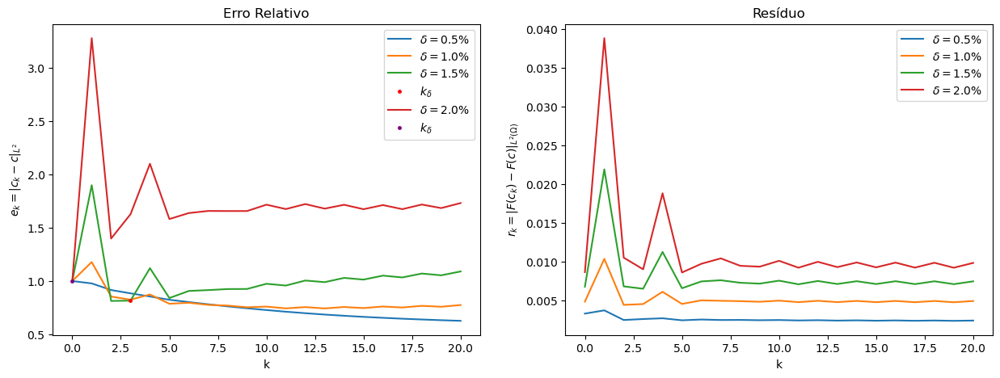

In [109]:
c_norm = funcSquareNorm(c)**0.5
u_norm = directOperatorNorm(u_delta_list)
fig, ax = plt.subplots(1,2, figsize=(15,5))
label_array = [f'$\delta = {delta_per}$%' for delta_per in delta_per_list]
color_list = ["blue","orange","red","purple"]

for  err_array, res_array,label,kdelta,delta_per,delta,color in zip(err_array_list,res_array_list,label_array,kdelta_list,delta_per_list,delta_list,color_list):
  ax[0].plot(err_array/c_norm,label=label)
  ax[1].plot(res_array/u_norm,label=label)
  if kdelta!=None and kdelta!=-1:
    ax[0].plot([kdelta],[err_array[kdelta]/c_norm],linestyle ='',marker='.',markersize=5,label='$k_\delta$',color=color)
    # ax[1].axhline(y=(1.05*delta)/u_norm,label='$\\tau \delta$',color=color)
    
ax[0].set_title("Erro Relativo")
ax[0].set_ylabel("$e_k = \|c_k - c\|_{L^2}$")
ax[0].set_xlabel("k")
ax[0].legend()

ax[1].set_title("Resíduo")
ax[1].set_ylabel("$r_k = \|F(c_k) - F(c)\|_{L^2(\Omega)}$")
ax[1].set_xlabel("k")
ax[1].legend()
plt.show()

In [110]:
print(kdelta_list)

[-1, -1, 3, 0]


In [111]:
err_list=[]
for ck in [ck1,ck2,ck3,ck4]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)

Error graphs:

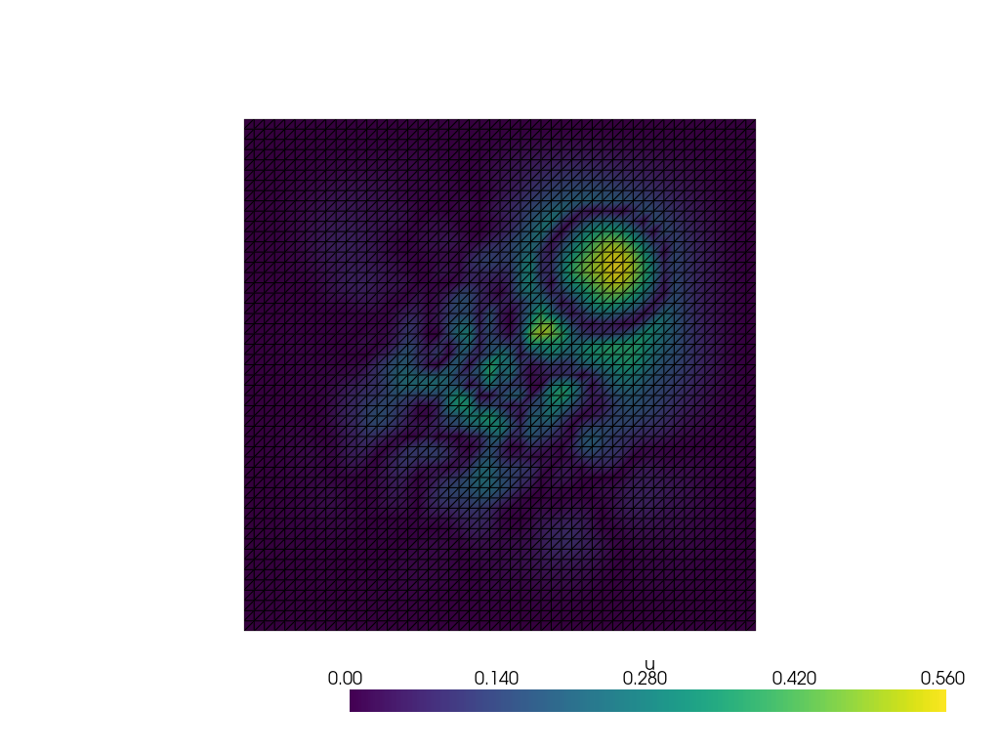

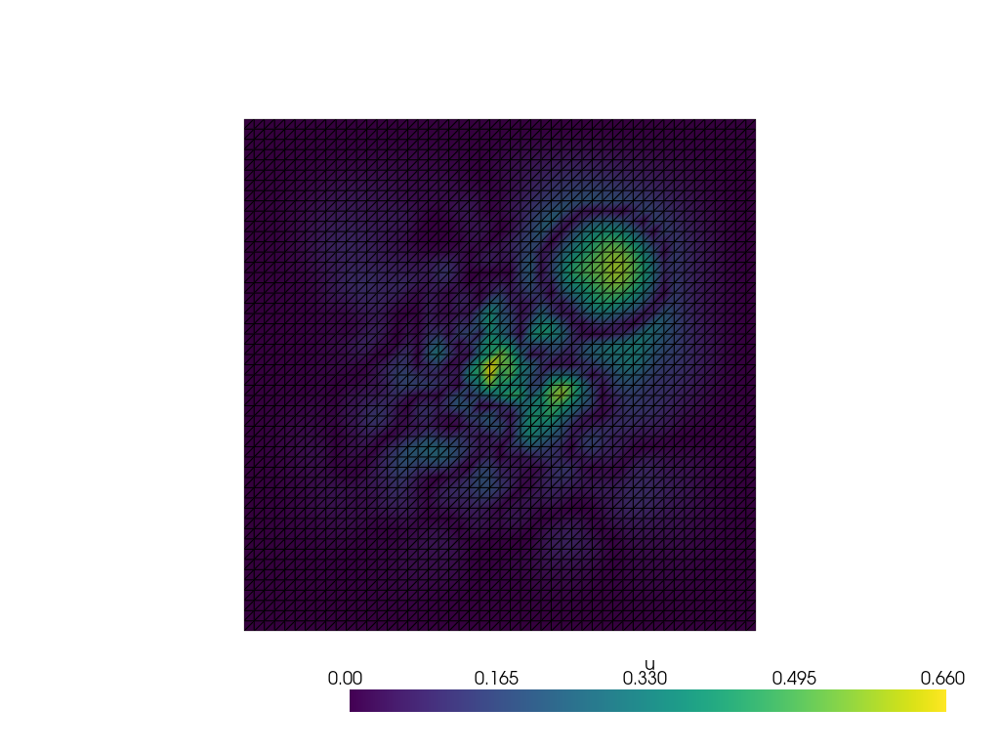

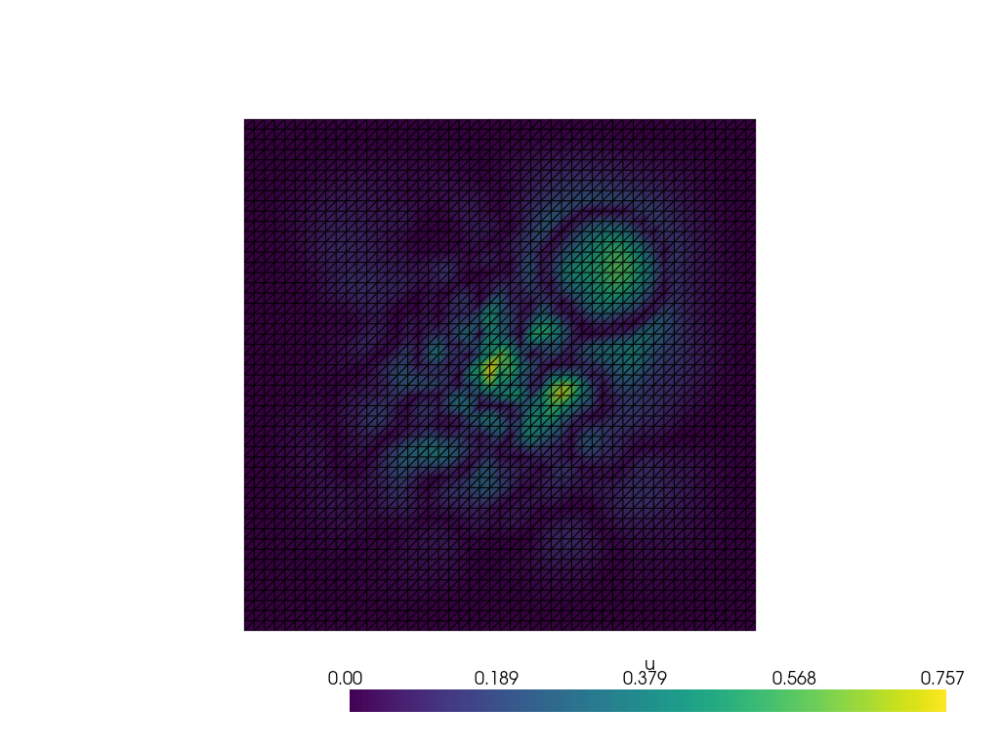

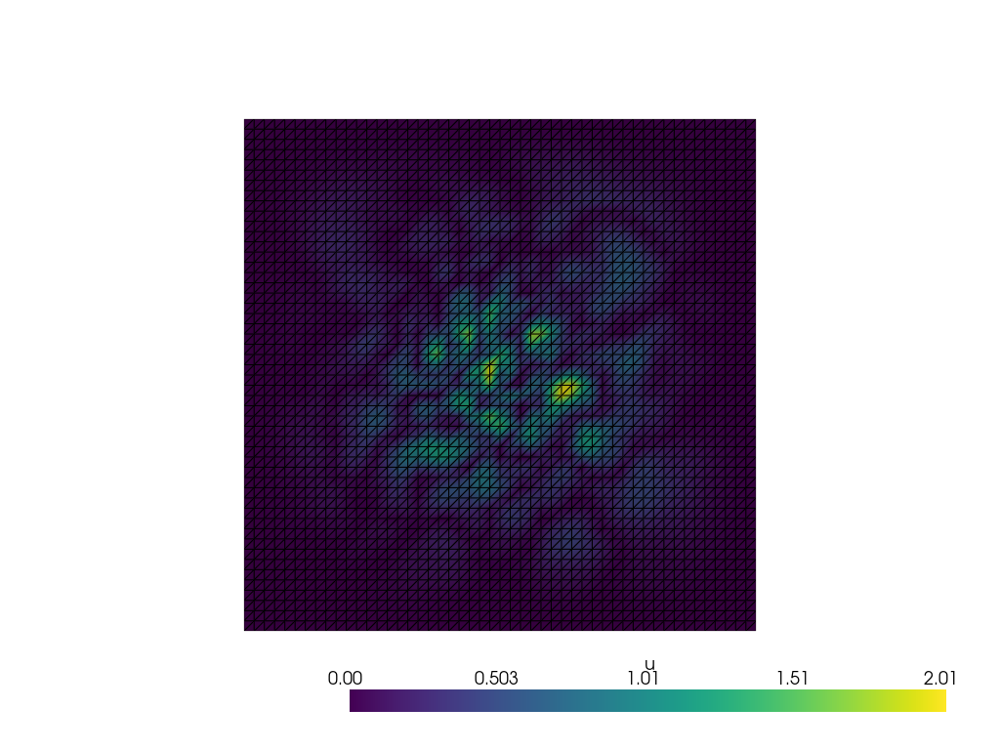

In [112]:
for err in err_list:
    plotFuncList([err])

Solution graphs

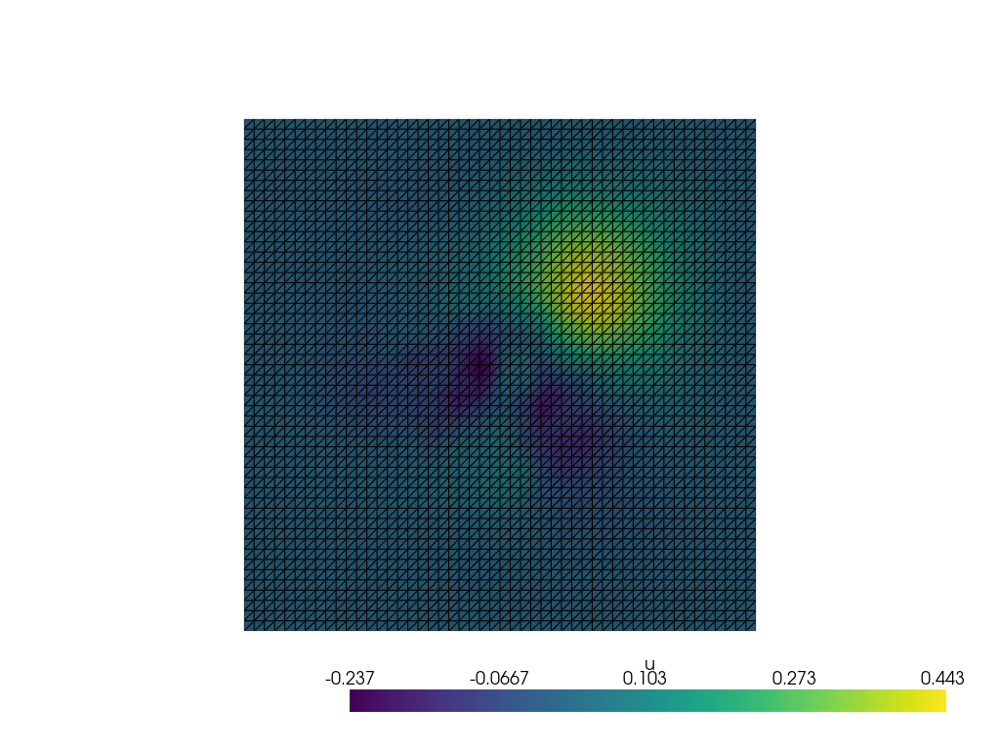

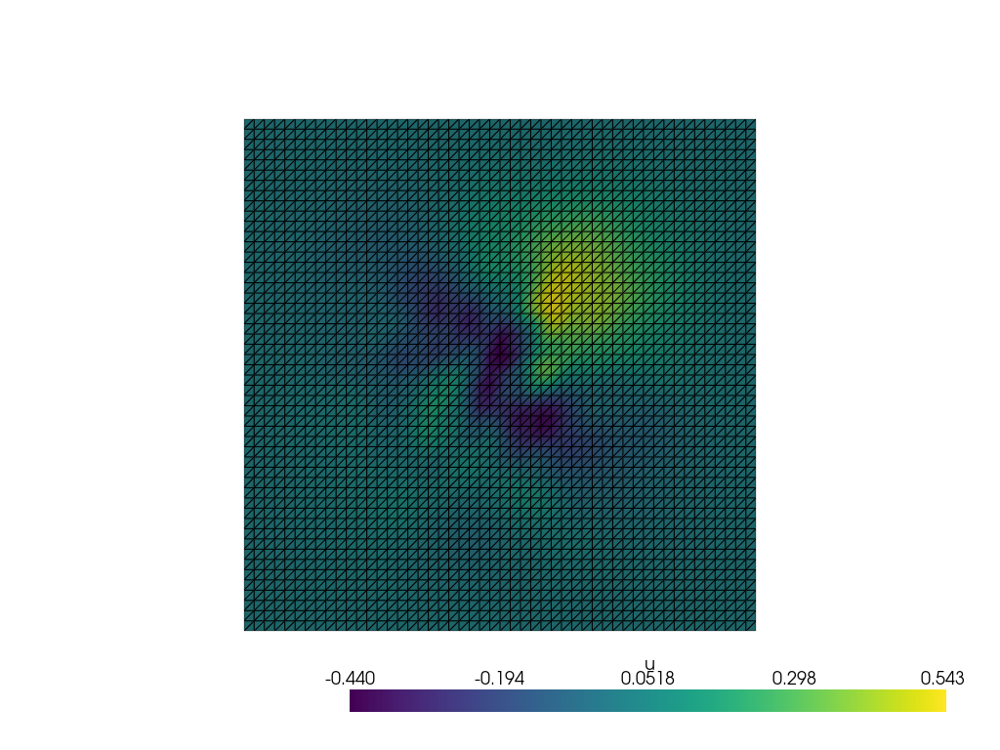

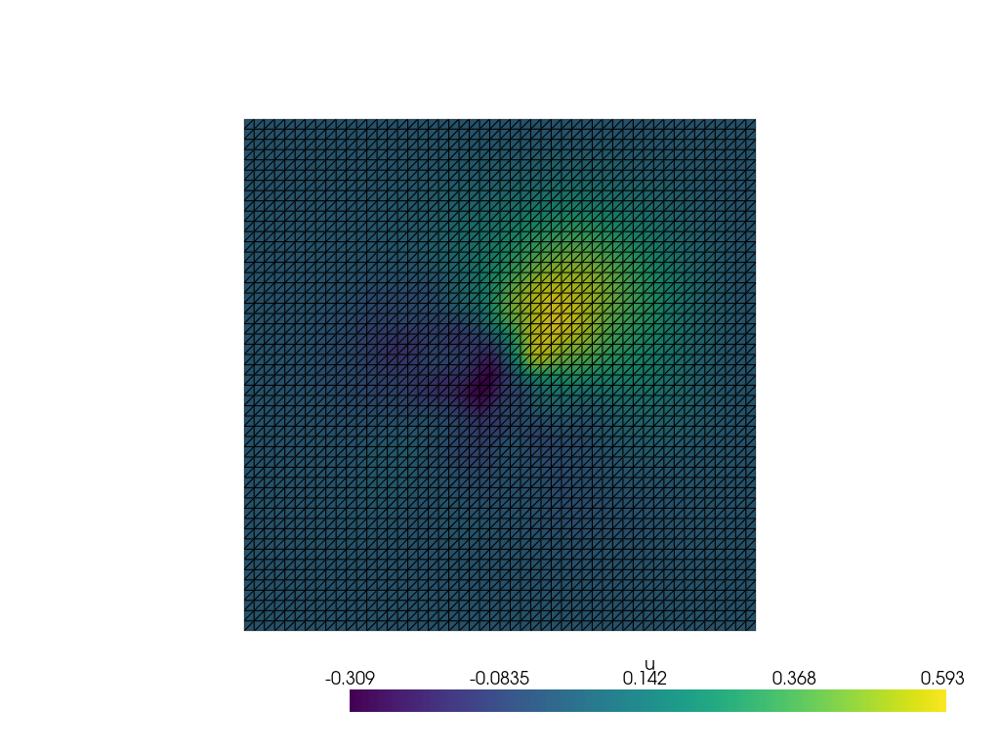

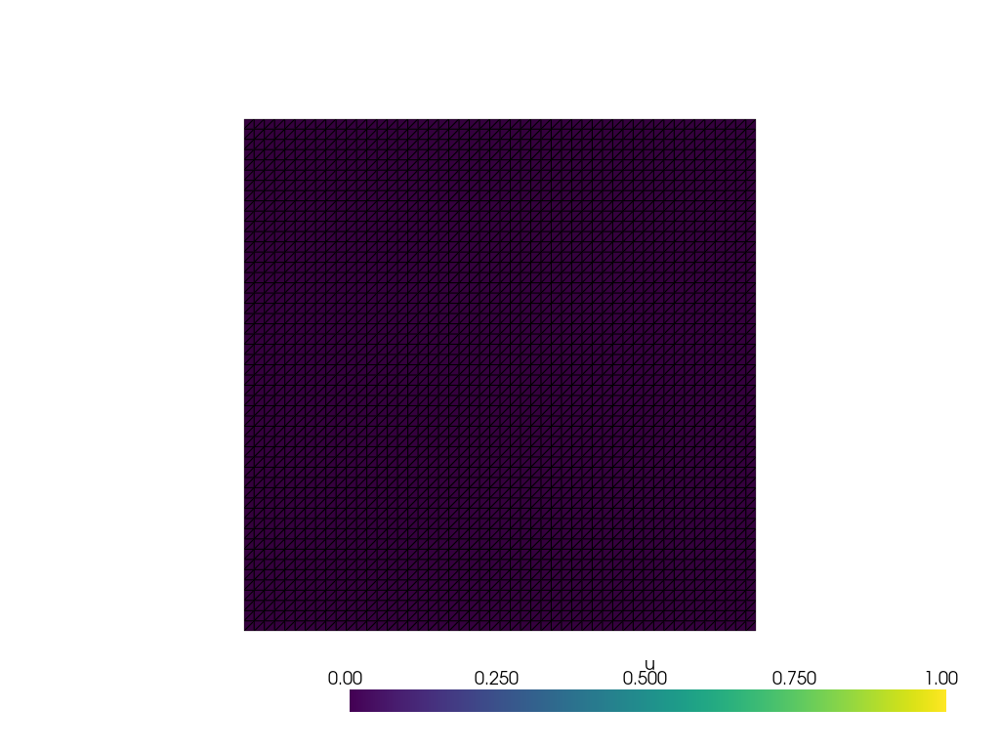

In [113]:
for ck in ck_list:
    plotFuncList([ck])

# Setting - Multiple Equations

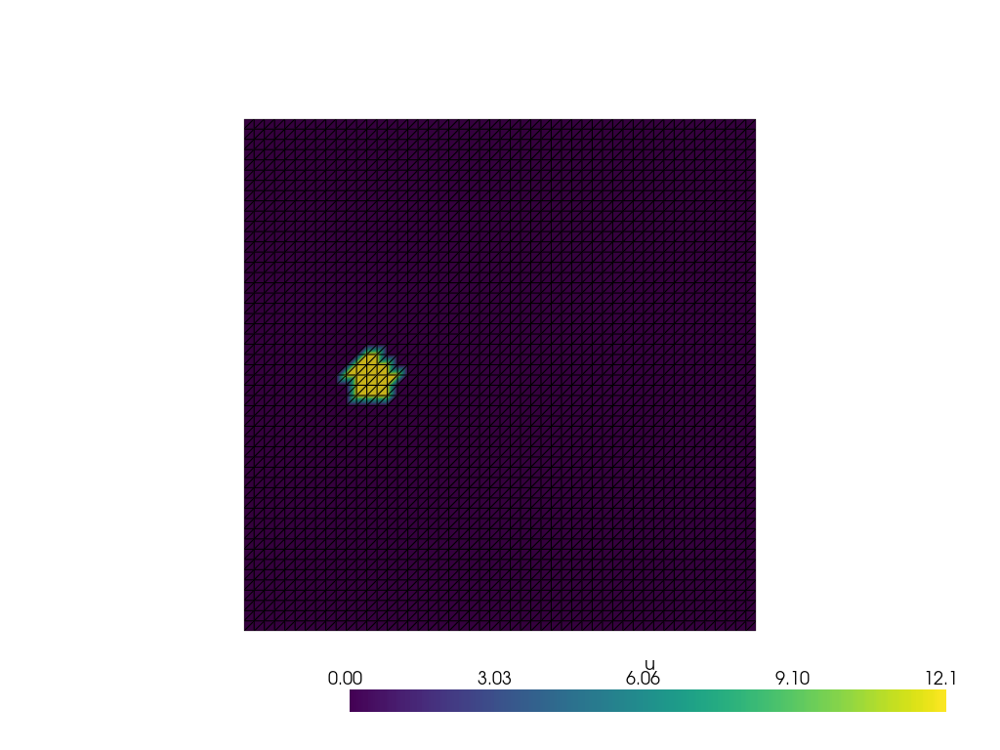

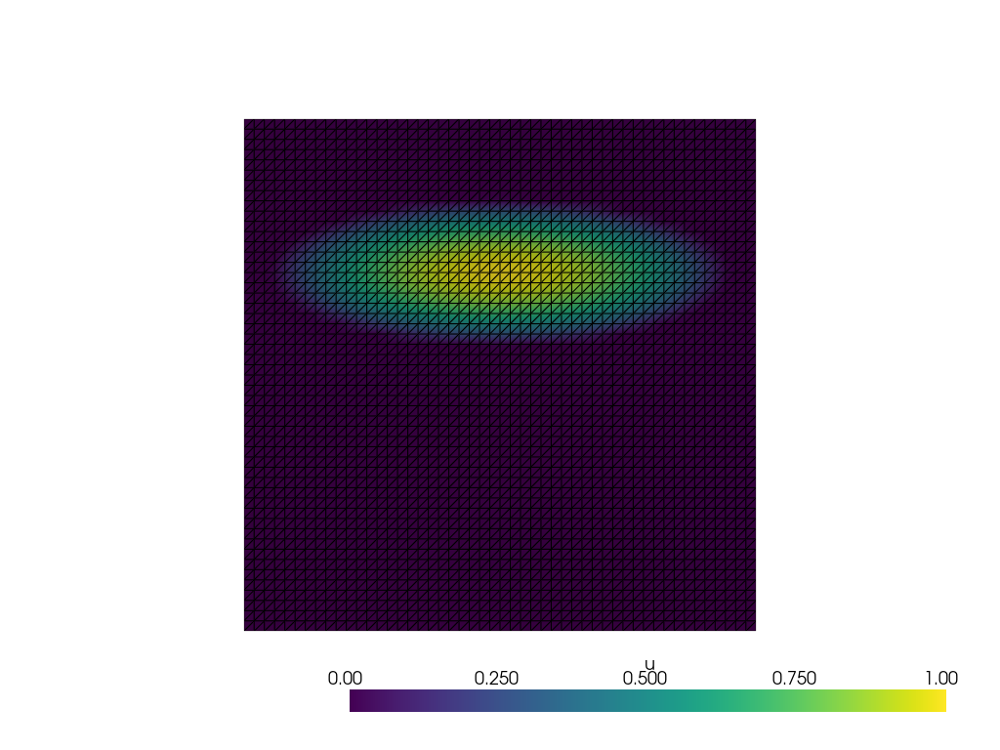

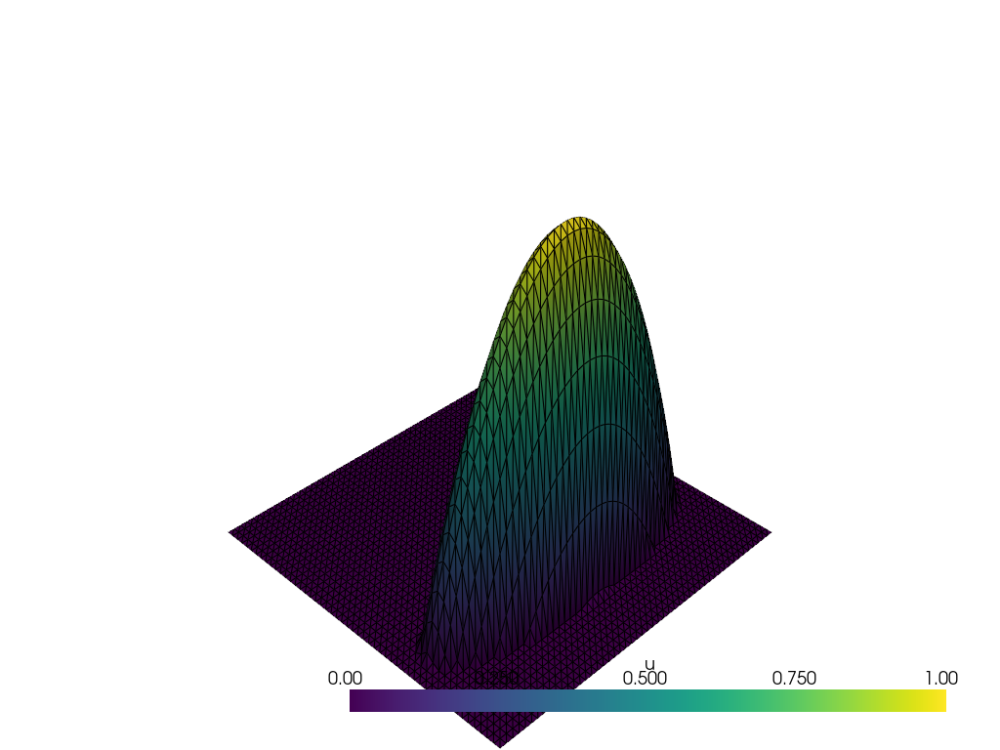

In [233]:
f_list = problem.createFiList(3,0.05)
plotFuncList([f_list[1]])
c = dolfinx.fem.Function(V)
const = 50
c.interpolate(lambda x: 1-0.1*const*(x[0]-0.5)**2-const*(x[1]-0.7)**2)
c.x.array[:] = np.where(c.x.array>=0, c.x.array, 0)
problem.plotFunc(c,warped=False)
problem.plotFunc(c,warped=True)

f_list1 = problem.createFiList(1,0.05,f_value=10)
u_list1 = problem.directOperator(c,f_list1)

f_list2 = problem.createFiList(4,0.05,f_value=10)
u_list2 = problem.directOperator(c,f_list2)

f_list3 = problem.createFiList(8,0.05,f_value=10)
u_list3 = problem.directOperator(c,f_list3)

In [234]:
%autoreload
inv_problem = InverseProblem(problem)


In [235]:
%time ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_list1,f_list1,c,lmbda0=1,lmbda_mult="ME",alpha=0.75,n_iter=200)

CPU times: user 3.3 s, sys: 244 ms, total: 3.55 s
Wall time: 3.55 s


In [236]:
%time ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_list2,f_list2,c,alpha=0,lmbda0=1,lmbda_mult="ME",n_iter=200)

CPU times: user 12.9 s, sys: 1.57 s, total: 14.4 s
Wall time: 14.5 s


In [237]:
%time ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_list3,f_list3,c,alpha=0,lmbda0=1,lmbda_mult="ME",n_iter=200)

CPU times: user 38.9 s, sys: 5.24 s, total: 44.2 s
Wall time: 44.2 s


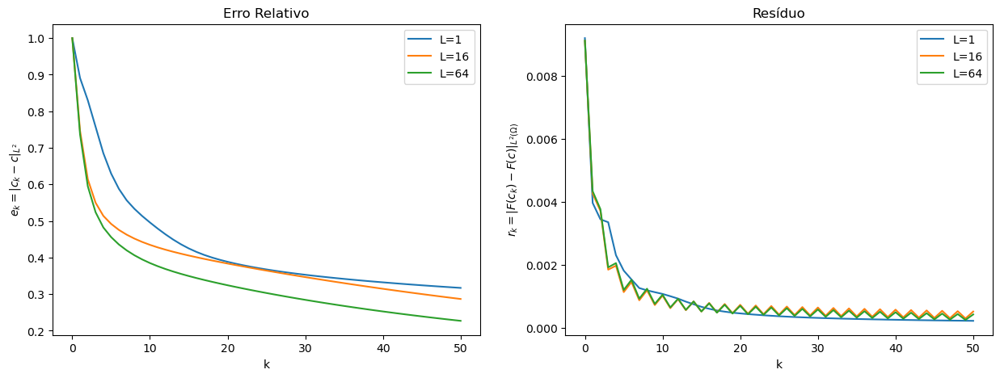

In [238]:
err_residual_graph_list(
    [err_array1,err_array2,err_array3],
    [res_array1,res_array2,res_array3],
    c,
    [u_list1,u_list2,u_list3]
)

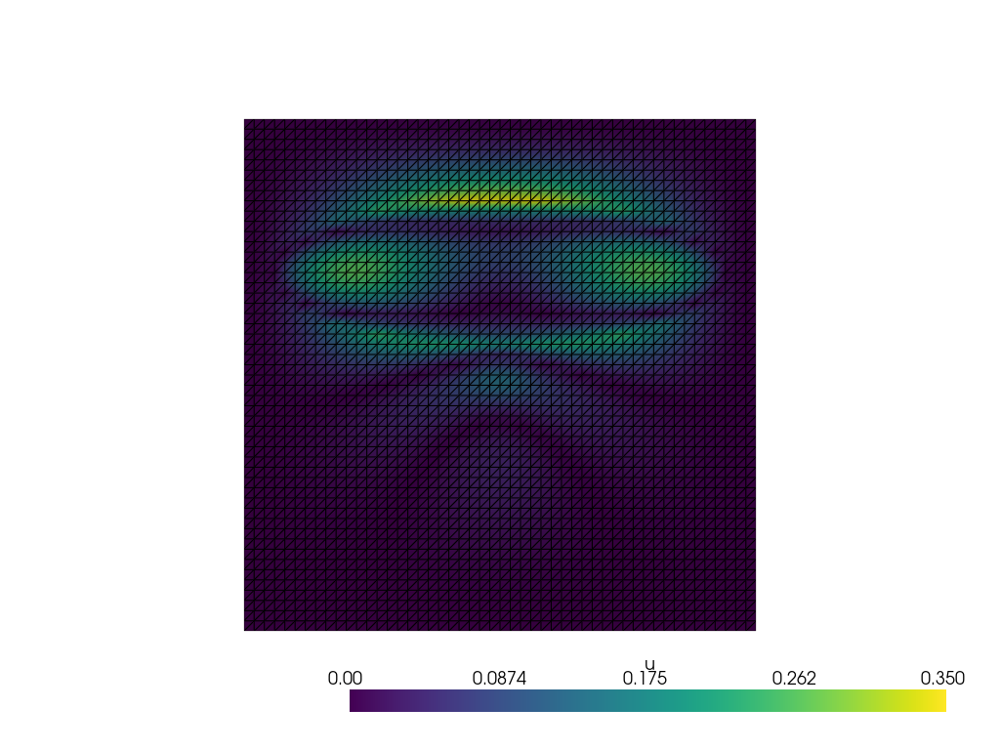

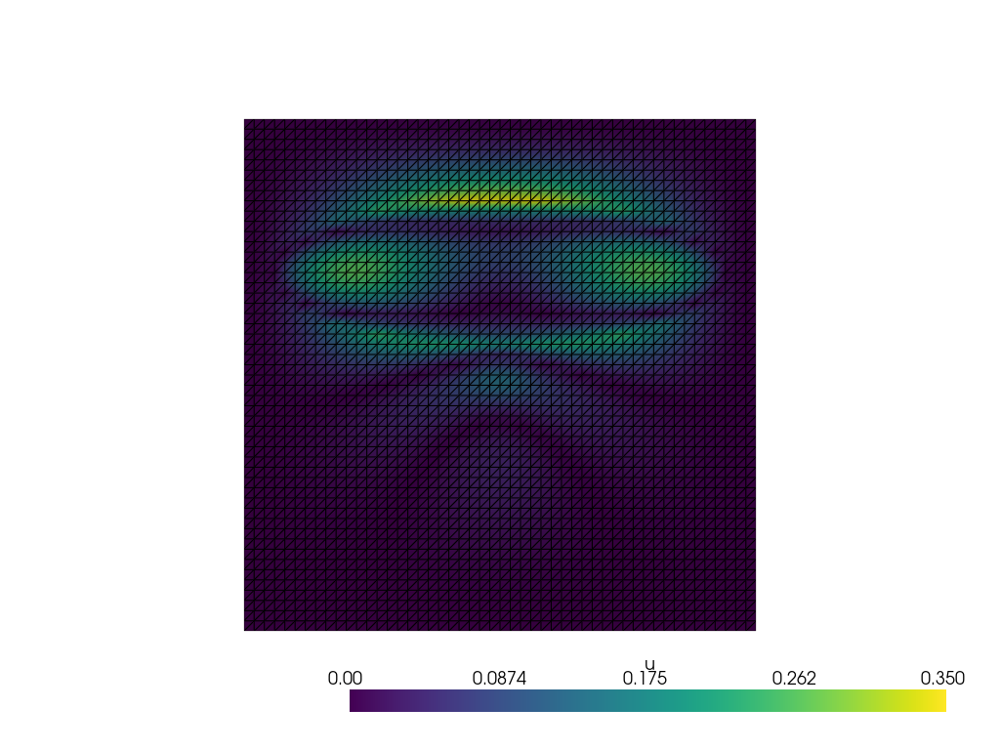

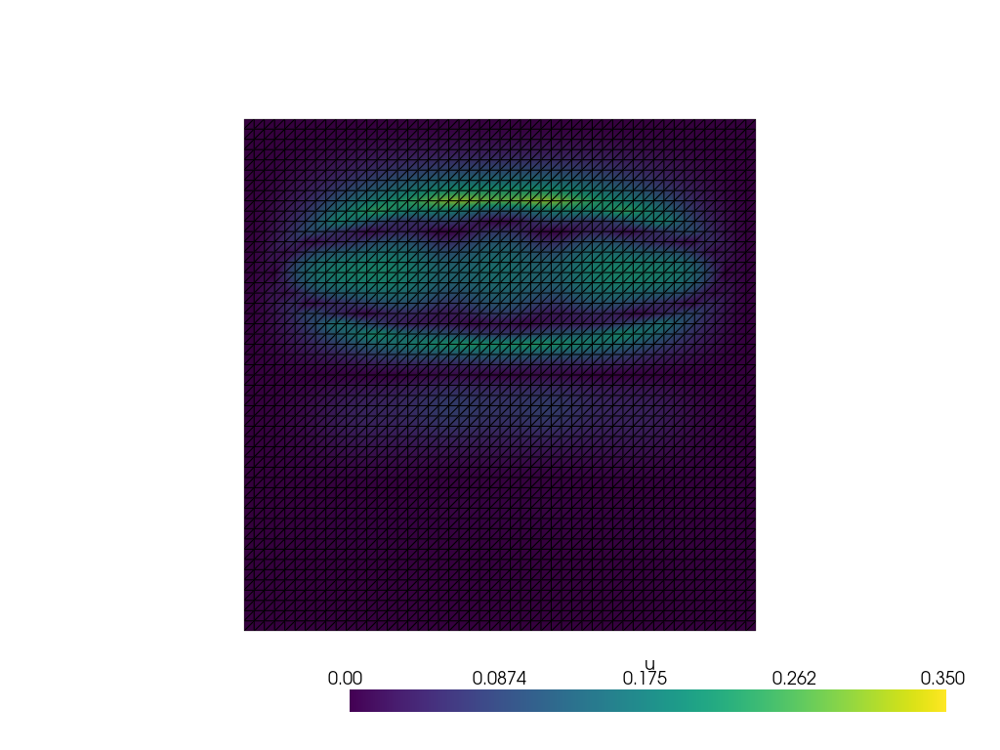

In [239]:
err_list=[]
for ck in [ck1,ck2,ck3]:
    err = dolfinx.fem.Function(V)
    err.x.array[:] = abs(ck.x.array-c.x.array)
    err_list.append(err)

plotFuncList(err_list)

### $\delta = 0.1\%$

In [240]:
### $\delta = 1\%$
%autoreload
inv_problem = InverseProblem(problem)
delta_per = 1
u_delta_list_1 = inv_problem.addNoise(u_list1,delta_per)
u_delta_list_2 = inv_problem.addNoise(u_list2,delta_per)
u_delta_list_3 = inv_problem.addNoise(u_list3,delta_per)
# delta = inv_problem.computeDelta(u_list1,u_delta_list)

In [248]:
%time ck1,kdelta1,err_array1,res_array1 = inv_problem.inLW(u_delta_list_1,f_list1,c,lmbda0=1,lmbda_mult="ME",alpha=0.75,delta=delta_per,tau=1.1,n_iter=50)

CPU times: user 2.59 s, sys: 170 ms, total: 2.76 s
Wall time: 2.76 s


In [249]:
%time ck2,kdelta2,err_array2,res_array2 = inv_problem.inLW(u_delta_list_2,f_list2,c,alpha=0,lmbda0=1,lmbda_mult="ME",delta=delta_per,tau=1.1,n_iter=50)

CPU times: user 14.3 s, sys: 1.72 s, total: 16 s
Wall time: 16 s


In [250]:
%time ck3,kdelta3,err_array3,res_array3 = inv_problem.inLW(u_delta_list_3,f_list3,c,alpha=0,lmbda0=1,lmbda_mult="ME",delta=delta_per,tau=1.1,n_iter=50)

CPU times: user 40.6 s, sys: 5.46 s, total: 46.1 s
Wall time: 46.3 s


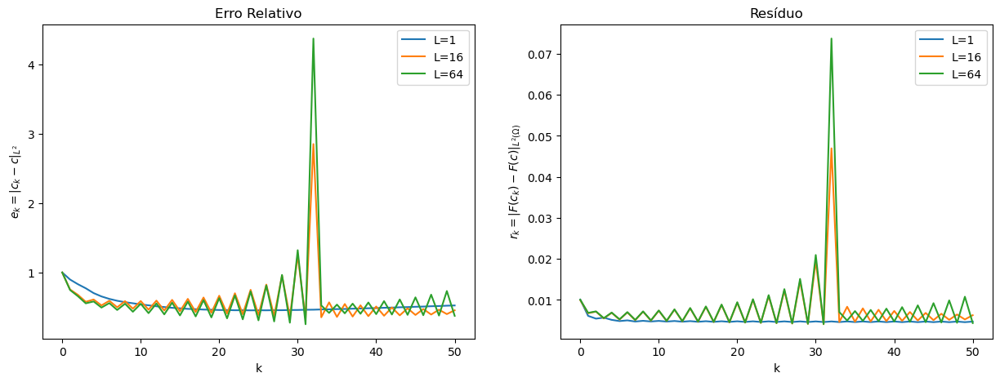

In [251]:
err_residual_graph_list(
    [err_array1,err_array2,err_array3],
    [res_array1,res_array2,res_array3],
    c,
    [u_list1,u_list2,u_list3]
)

In [253]:
print(kdelta1,kdelta2,kdelta3)

0 0 0
